# Spaceship Titanic

---

Предсказать, какие пассажиры попадут в альтернативное измерение

## Описание соревнования

---

Добро пожаловать в 2912 год, где ваши навыки работы с данными необходимы для решения космической загадки. Мы получили сообщение с расстояния в четыре световых года, и ситуация выглядит не лучшим образом.

Космический корабль "Титаник" - межзвездный пассажирский лайнер, запущенный месяц назад. В свой первый рейс судно отправилось с почти 13 тысячами пассажиров, доставив эмигрантов из нашей Солнечной системы на три новые пригодные для жизни экзопланеты, вращающиеся вокруг ближайших звезд.

Огибая Альфу Центавра и направляясь к первому пункту назначения - горячему 55 Cancri E, космический корабль "Титаник" столкнулся с пространственно-временной аномалией, скрытой в пылевом облаке. К сожалению, его постигла та же участь, что и его тезку за 1000 лет до этого. Хотя корабль остался цел, почти половина пассажиров была перенесена в другое измерение!

![Spaceship Titanic](https://storage.googleapis.com/kaggle-media/competitions/Spaceship%20Titanic/joel-filipe-QwoNAhbmLLo-unsplash.jpg)

Чтобы помочь спасателям и вернуть потерянных пассажиров, вам предстоит предсказать, какие пассажиры попали в аномалию, используя записи, извлеченные из поврежденной компьютерной системы космического корабля.

Помогите спасти их и изменить историю!


Addison Howard, Ashley Chow, Ryan Holbrook. (2022). Spaceship Titanic. Kaggle. https://kaggle.com/competitions/spaceship-titanic



## Описание набора данных

---

Основная задача - предсказать, был ли пассажир перенесен в альтернативное измерение во время столкновения космического корабля "Титаник" с пространственно-временной аномалией. Для того чтобы сделать этот прогноз, нам предоставлен набор личных записей, извлеченных из поврежденной компьютерной системы корабля.

### Описания файлов и значений полей данных

---

**train.csv** - Личные дела примерно двух третей (\~8700) пассажиров, которые будут использоваться в качестве обучающих данных.
**test.csv** - личные дела оставшейся трети (\~4300) пассажиров, которые будут использоваться в качестве тестовых данных.

> Задача - предсказать значение параметра **Transported** для пассажиров из набора **test.csv**.

- **PassengerId** - Уникальный идентификатор для каждого пассажира. Каждый идентификатор имеет вид `gggg_pp`, где `gggg` означает группу, с которой едет пассажир, а `pp` - его номер в группе. Люди в группе часто являются членами семьи, _но не всегда_.
- **HomePlanet** - Планета, с которой пассажир вылетел, обычно это планета его постоянного проживания.
- **CryoSleep** - Указывает, желает ли пассажир быть переведенным в состояние условной анимации на время путешествия. _Пассажиры, находящиеся в криосне, находятся в своих каютах._
- **Cabin** - Номер каюты, в которой находится пассажир. Имеет вид deck/num/side, где side может быть либо P - Port, либо S - Starboard.
- **Destination** - Планета, на которой пассажир будет высаживаться.
- **Age** - Возраст пассажира.
- **VIP** - Оплатил ли пассажир специальное VIP-обслуживание во время рейса.
- **RoomService**, **FoodCourt**, **ShoppingMall**, **Spa**, **VRDeck** - Сумма, которую пассажир оплатил в каждом из многочисленных роскошных сервисов космического корабля "Титаник".
- **Name** - Имя и фамилия пассажира.
- **Transported** - Был ли пассажир перевезен в другое измерение. Это целевой столбец, который пытаемся предсказать.

--

**sample_submission.csv** - Файл отправки в правильном формате.
- **PassengerId** - Идентификатор каждого пассажира в тестовом наборе.
- **Transported** - Цель. Для каждого пассажира предсказать значение True или False.

# Установка библиотек

---


In [236]:
# ! pip3 install catboost

# Импорт библиотек

---

In [1]:
import multiprocessing
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import cm
import seaborn as sns

from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer, SimpleImputer
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.cluster import KMeans
from sklearn.model_selection import cross_val_score, train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import (
    mean_absolute_percentage_error, mean_squared_error, max_error, mean_absolute_error,
    classification_report, ConfusionMatrixDisplay, confusion_matrix
)

import lightgbm as lgb
import catboost as cb
import xgboost as xgb

%matplotlib inline

In [238]:
# !nvidia-smi

# Загрузка данных

---

In [239]:
# from google.colab import files, drive
# # uploaded = files.upload()
# drive.mount("/content/drive")

## Файл train.csv

---

In [3]:
df_train = pd.read_csv("/Users/mac/education/sber_university/main/2. RN/group_project/2/data/spaceship-titanic/train.csv")
df_train.head()

,PassengerId,HomePlanet,CryoSleep,Cabin,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Name,Transported
0,0001_01,Europa,False,B/0/P,TRAPPIST-1e,39.0,False,0.0,0.0,0.0,0.0,0.0,Maham Ofracculy,False
1,0002_01,Earth,False,F/0/S,TRAPPIST-1e,24.0,False,109.0,9.0,25.0,549.0,44.0,Juanna Vines,True
2,0003_01,Europa,False,A/0/S,TRAPPIST-1e,58.0,True,43.0,3576.0,0.0,6715.0,49.0,Altark Susent,False
3,0003_02,Europa,False,A/0/S,TRAPPIST-1e,33.0,False,0.0,1283.0,371.0,3329.0,193.0,Solam Susent,False
4,0004_01,Earth,False,F/1/S,TRAPPIST-1e,16.0,False,303.0,70.0,151.0,565.0,2.0,Willy Santantines,True


Проверим общую информацию о данных:

In [4]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8693 entries, 0 to 8692
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   PassengerId   8693 non-null   object 
 1   HomePlanet    8492 non-null   object 
 2   CryoSleep     8476 non-null   object 
 3   Cabin         8494 non-null   object 
 4   Destination   8511 non-null   object 
 5   Age           8514 non-null   float64
 6   VIP           8490 non-null   object 
 7   RoomService   8512 non-null   float64
 8   FoodCourt     8510 non-null   float64
 9   ShoppingMall  8485 non-null   float64
 10  Spa           8510 non-null   float64
 11  VRDeck        8505 non-null   float64
 12  Name          8493 non-null   object 
 13  Transported   8693 non-null   bool   
dtypes: bool(1), float64(6), object(7)
memory usage: 891.5+ KB


Кол-во уникальных значений в каждом столбце:

In [5]:
df_train.nunique()

PassengerId     8693
HomePlanet         3
CryoSleep          2
Cabin           6560
Destination        3
Age               80
VIP                2
RoomService     1273
FoodCourt       1507
ShoppingMall    1115
Spa             1327
VRDeck          1306
Name            8473
Transported        2
dtype: int64

В данных видим три столбца, имеющих только два уникальных значения. Это столбцы **CryoSleep**, **VIP** и **Transported**. Скорее всего, это бинарные признаки.
В столбцах **HomePlanet** и **Destination** по 3 уникальных значения.
И остальные многоуникальные признаки.

Рассмотрим таргет:

In [6]:
target_col = "Transported"
df_train[target_col].value_counts()

Transported
True     4378
False    4315
Name: count, dtype: int64

In [7]:
df_train[target_col].value_counts(normalize=True)

Transported
True     0.503624
False    0.496376
Name: proportion, dtype: float64

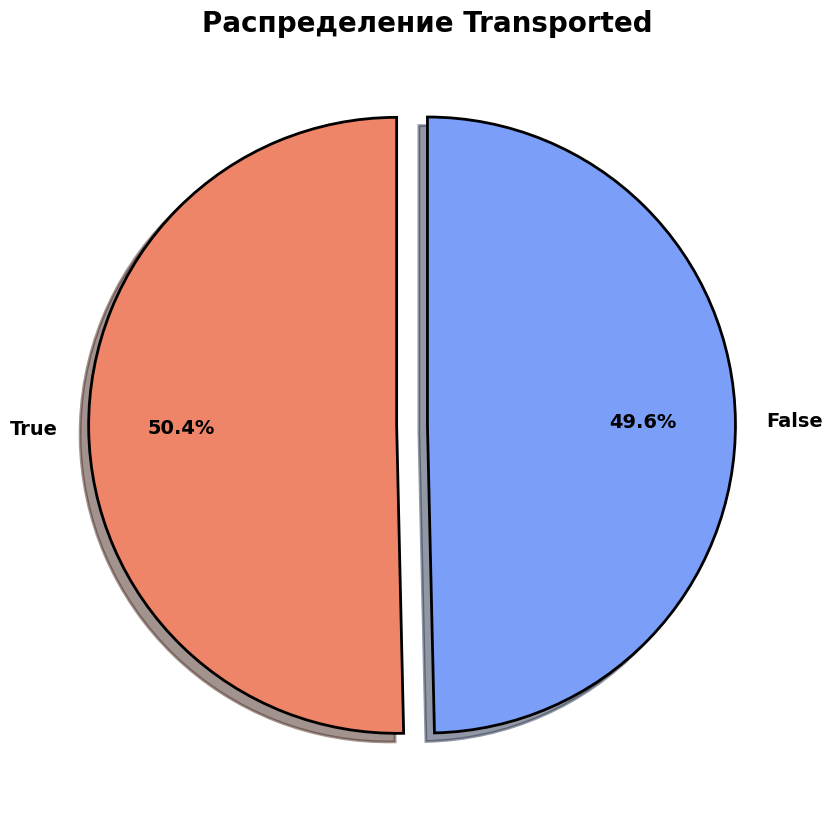

In [8]:
def plot_target_pie(df_: pd.DataFrame, col_: str) -> None:
    plt.figure(figsize=(10, 10))
    plt.pie(
        df_[col_].value_counts(),
        labels=df_[col_].value_counts().index,
        labeldistance=1.1,
        autopct="%1.1f%%",
        pctdistance=0.7,
        textprops={
            "fontsize": 14,
            "fontweight": "bold",
            "color": "black"
        },
        colors=cm.get_cmap("coolwarm")(np.linspace(0.8, 0.2, df_[col_].nunique())),
        wedgeprops = {
            "edgecolor": "black",
            "linewidth": 2,
            "antialiased": True
        },
        explode=(0.1, 0),
        startangle=90,
        shadow=True
    )
    plt.title(f"Распределение {col_}", fontsize=20, fontweight="bold")
    plt.ylabel("")
    plt.show()

plot_target_pie(df_train, target_col)

Видим, что целевой **признак сбалансирован**.

## Файл test.csv

---

In [9]:
df_test = pd.read_csv("/Users/mac/education/sber_university/main/2. RN/group_project/2/data/spaceship-titanic/test.csv")
df_test.head()

,PassengerId,HomePlanet,CryoSleep,Cabin,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Name
0,0013_01,Earth,True,G/3/S,TRAPPIST-1e,27.0,False,0.0,0.0,0.0,0.0,0.0,Nelly Carsoning
1,0018_01,Earth,False,F/4/S,TRAPPIST-1e,19.0,False,0.0,9.0,0.0,2823.0,0.0,Lerome Peckers
2,0019_01,Europa,True,C/0/S,55 Cancri e,31.0,False,0.0,0.0,0.0,0.0,0.0,Sabih Unhearfus
3,0021_01,Europa,False,C/1/S,TRAPPIST-1e,38.0,False,0.0,6652.0,0.0,181.0,585.0,Meratz Caltilter
4,0023_01,Earth,False,F/5/S,TRAPPIST-1e,20.0,False,10.0,0.0,635.0,0.0,0.0,Brence Harperez


Проверим общую информацию о данных:

In [10]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4277 entries, 0 to 4276
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   PassengerId   4277 non-null   object 
 1   HomePlanet    4190 non-null   object 
 2   CryoSleep     4184 non-null   object 
 3   Cabin         4177 non-null   object 
 4   Destination   4185 non-null   object 
 5   Age           4186 non-null   float64
 6   VIP           4184 non-null   object 
 7   RoomService   4195 non-null   float64
 8   FoodCourt     4171 non-null   float64
 9   ShoppingMall  4179 non-null   float64
 10  Spa           4176 non-null   float64
 11  VRDeck        4197 non-null   float64
 12  Name          4183 non-null   object 
dtypes: float64(6), object(7)
memory usage: 434.5+ KB


Кол-во уникальных значений в каждом столбце:

In [11]:
df_test.nunique()

PassengerId     4277
HomePlanet         3
CryoSleep          2
Cabin           3265
Destination        3
Age               79
VIP                2
RoomService      842
FoodCourt        902
ShoppingMall     715
Spa              833
VRDeck           796
Name            4176
dtype: int64

## Объединение данных

---

Объединим обучающую и тестовую выборки для удобства предобработки данных:

In [12]:
df = pd.concat([df_train, df_test], axis=0, ignore_index=True)
df.fillna(np.nan, inplace=True)
df.head()

,PassengerId,HomePlanet,CryoSleep,Cabin,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Name,Transported
0,0001_01,Europa,False,B/0/P,TRAPPIST-1e,39.0,False,0.0,0.0,0.0,0.0,0.0,Maham Ofracculy,False
1,0002_01,Earth,False,F/0/S,TRAPPIST-1e,24.0,False,109.0,9.0,25.0,549.0,44.0,Juanna Vines,True
2,0003_01,Europa,False,A/0/S,TRAPPIST-1e,58.0,True,43.0,3576.0,0.0,6715.0,49.0,Altark Susent,False
3,0003_02,Europa,False,A/0/S,TRAPPIST-1e,33.0,False,0.0,1283.0,371.0,3329.0,193.0,Solam Susent,False
4,0004_01,Earth,False,F/1/S,TRAPPIST-1e,16.0,False,303.0,70.0,151.0,565.0,2.0,Willy Santantines,True


In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12970 entries, 0 to 12969
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   PassengerId   12970 non-null  object 
 1   HomePlanet    12682 non-null  object 
 2   CryoSleep     12660 non-null  object 
 3   Cabin         12671 non-null  object 
 4   Destination   12696 non-null  object 
 5   Age           12700 non-null  float64
 6   VIP           12674 non-null  object 
 7   RoomService   12707 non-null  float64
 8   FoodCourt     12681 non-null  float64
 9   ShoppingMall  12664 non-null  float64
 10  Spa           12686 non-null  float64
 11  VRDeck        12702 non-null  float64
 12  Name          12676 non-null  object 
 13  Transported   8693 non-null   object 
dtypes: float64(6), object(8)
memory usage: 1.4+ MB


In [14]:
df.describe()

,Age,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck
count,12700.000000,12707.000000,12681.000000,12664.000000,12686.000000,12702.000000
mean,28.771969,222.897852,451.961675,174.906033,308.476904,306.789482
std,14.387261,647.596664,1584.370747,590.558690,1130.279641,1180.097223
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,19.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,27.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,38.000000,49.000000,77.000000,29.000000,57.000000,42.000000
max,79.000000,14327.000000,29813.000000,23492.000000,22408.000000,24133.000000


# Предобработка и анализ данных

---

## Пропуски

---

Кол-во пропусков:

In [15]:
def print_null_values(df_: pd.DataFrame) -> None:
    mask = ~(df_.columns.isin(["PassengerId", "Transported"]))
    row = df_.loc[:, mask].shape[0]
    for col in df_.loc[:, mask].columns:
        values = df_[col].count()
        missing_values = df_[col].isnull().sum()
        perc = (values / row) * 100
        print(f"{col:^12} -> всего: {values:^5}, пропущенных значений: {missing_values:^3}, {100 - perc:.2f}%")


print_null_values(df)

 HomePlanet  -> всего: 12682, пропущенных значений: 288, 2.22%
 CryoSleep   -> всего: 12660, пропущенных значений: 310, 2.39%
   Cabin     -> всего: 12671, пропущенных значений: 299, 2.31%
Destination  -> всего: 12696, пропущенных значений: 274, 2.11%
    Age      -> всего: 12700, пропущенных значений: 270, 2.08%
    VIP      -> всего: 12674, пропущенных значений: 296, 2.28%
RoomService  -> всего: 12707, пропущенных значений: 263, 2.03%
 FoodCourt   -> всего: 12681, пропущенных значений: 289, 2.23%
ShoppingMall -> всего: 12664, пропущенных значений: 306, 2.36%
    Spa      -> всего: 12686, пропущенных значений: 284, 2.19%
   VRDeck    -> всего: 12702, пропущенных значений: 268, 2.07%
    Name     -> всего: 12676, пропущенных значений: 294, 2.27%


В столбцах, которые имеют пропуски, их кол-во варьируется от 263 до 310. Возможно, что в данных имеются строки, в которых пропущены значения во всех столбцах, кроме **PassengerId**.
Проверим это:

In [33]:
def print_null_values(df_: pd.DataFrame) -> None:
    columns_ = [col for col in df_.columns if col not in ["PassengerId", target_col]]
    for i in range(len(columns_)):
        count_val = df_[columns_].isnull().sum(axis=1) == i
        print(f"Кол-во строк, в которых пропущено {i} значений: {count_val.sum()}")
        

print_null_values(df)

Кол-во строк, в которых пропущено 0 значений: 9887
Кол-во строк, в которых пропущено 1 значений: 2746
Кол-во строк, в которых пропущено 2 значений: 316
Кол-во строк, в которых пропущено 3 значений: 21
Кол-во строк, в которых пропущено 4 значений: 0
Кол-во строк, в которых пропущено 5 значений: 0
Кол-во строк, в которых пропущено 6 значений: 0
Кол-во строк, в которых пропущено 7 значений: 0
Кол-во строк, в которых пропущено 8 значений: 0
Кол-во строк, в которых пропущено 9 значений: 0
Кол-во строк, в которых пропущено 10 значений: 0
Кол-во строк, в которых пропущено 11 значений: 0
Кол-во строк, в которых пропущено 12 значений: 0
Кол-во строк, в которых пропущено 13 значений: 0


Гипотеза о пропусках во всех столбцах, кроме **PassengerId**, не подтвердилась. Оказалось, что максимальное кол-во пропусков в строке - 3 (в 21 строках). В 316 строках пропущено 2 значения, в 2746 - 1 значение, в остальных - 0. Вероятно, используя сходство 10-11 признакам, мы можем достаточно достоверно восстанавливать проопущенные значения.

## Дубликаты

---

Проверим наличие дубликатов:

In [34]:
print(f"Число дублей: {df.duplicated().sum():^5}, ({df.duplicated().sum() / df.shape[0] * 100:.2f}%)")

Число дублей:   0  , (0.00%)


## Тип признаков

---

Разделим данные на категориальные многозначные, категориальные бинарные и числовые признаки:

In [35]:
target_col = "Transported"

num_cols = df.select_dtypes(include=np.number).columns.tolist()
cat_cols = df.select_dtypes(exclude=np.number).columns.tolist()

bin_cols = [col for col in cat_cols if df[col].nunique() == 2]
cat_cols = [col for col in cat_cols if col not in bin_cols]

cols_lst = num_cols + cat_cols + bin_cols

print("Категориальные признаки:", ", ".join(cat_cols), f"({len(cat_cols)} шт.)")
print("Бинарные признаки:      ", ", ".join(bin_cols), f"({len(bin_cols)} шт.)")
print("Числовые признаки:      ", ", ".join(num_cols), f"({len(num_cols)} шт.)")

Категориальные признаки: HomePlanet, Cabin, Destination, Name (4 шт.)
Бинарные признаки:       CryoSleep, VIP, Transported (3 шт.)
Числовые признаки:       Age, RoomService, FoodCourt, ShoppingMall, Spa, VRDeck, PassengerIdGroup, PassengerIdNum (8 шт.)


### Категориальные признаки

---

#### PassengerId

---

Как следует из описания - это уникальный идентификатор для каждого пассажира. Каждый идентификатор имеет вид `gggg_pp`, где `gggg` означает группу, с которой едет пассажир, а `pp` - его номер в группе. Люди в группе часто являются членами семьи, _но не всегда_.

Для удобства разделим этот столбец на два: **PassengerIdGroup** и **PassengerIdNum**

In [23]:
def split_passenger_id(df_: pd.DataFrame) -> pd.DataFrame:
    df_["PassengerIdGroup"] = df_.PassengerId.str.slice(0, 4)
    df_["PassengerIdNum"] = df_.PassengerId.str.slice(5, 7)

    df_.PassengerIdGroup = df_.PassengerIdGroup.astype(int)
    df_.PassengerIdNum = df_.PassengerIdNum.astype(int)

    df_.drop("PassengerId", axis=1, inplace=True)

    print(f"{df_.PassengerIdGroup.nunique()} уникальных значений в столбце PassengerIdGroup")
    print(f"{df_.PassengerIdNum.nunique()} уникальных значений в столбце PassengerIdNum")

    return df_


df = split_passenger_id(df)
df.head()

9280 уникальных значений в столбце PassengerIdGroup
8 уникальных значений в столбце PassengerIdNum


,HomePlanet,CryoSleep,Cabin,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Name,Transported,PassengerIdGroup,PassengerIdNum
0,Europa,False,B/0/P,TRAPPIST-1e,39.0,False,0.0,0.0,0.0,0.0,0.0,Maham Ofracculy,False,1,1
1,Earth,False,F/0/S,TRAPPIST-1e,24.0,False,109.0,9.0,25.0,549.0,44.0,Juanna Vines,True,2,1
2,Europa,False,A/0/S,TRAPPIST-1e,58.0,True,43.0,3576.0,0.0,6715.0,49.0,Altark Susent,False,3,1
3,Europa,False,A/0/S,TRAPPIST-1e,33.0,False,0.0,1283.0,371.0,3329.0,193.0,Solam Susent,False,3,2
4,Earth,False,F/1/S,TRAPPIST-1e,16.0,False,303.0,70.0,151.0,565.0,2.0,Willy Santantines,True,4,1


In [20]:
df[["PassengerIdGroup", "PassengerIdNum"]].describe()

,PassengerIdGroup,PassengerIdNum
count,12970.000000,12970.000000
mean,4635.337471,1.511488
std,2685.904299,1.042500
min,1.000000,1.000000
25%,2306.250000,1.000000
50%,4632.000000,1.000000
75%,6924.750000,2.000000
max,9280.000000,8.000000


Всего 9280 групп, а пассажиров в группе может быть от 1 до 8. Посмотрим на распределение кол-ва пассажиров в группе:

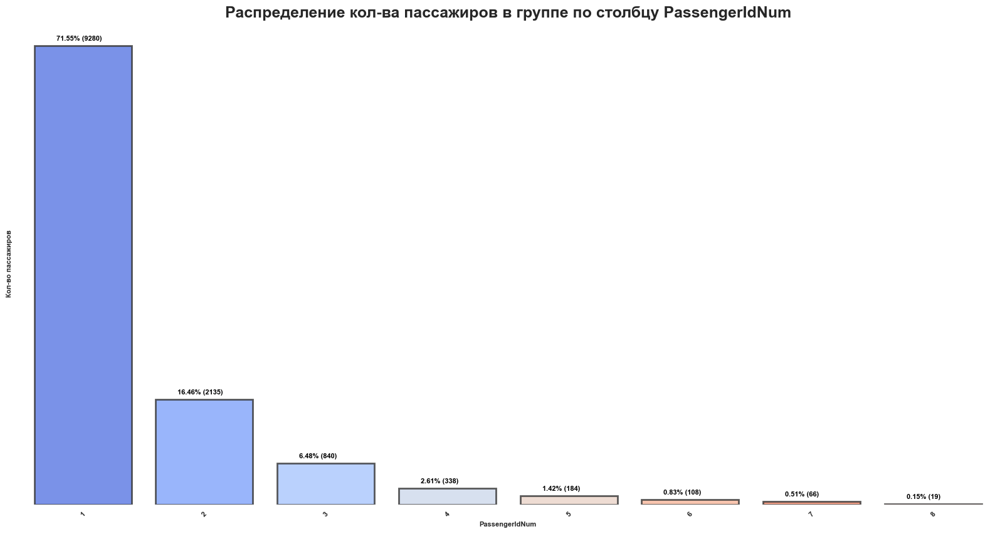

In [42]:
def plot_dist(df_: pd.DataFrame, col_: str, text_: bool = False) -> None:
    df_group_ = df_.groupby([col_]).size()

    plt.figure(figsize=(20, 10))

    ax = sns.barplot(
        data=df_group_.reset_index(name="count"),
        x=col_,
        y="count",
        linewidth=2,
        edgecolor="0.2",
        palette=cm.get_cmap("coolwarm")(np.linspace(0.1, 0.9, df_[col_].nunique())),
        saturation=1,
        alpha=0.8,
        hue_order=[False, True]
    )

    ax.set_title(f"Распределение кол-ва пассажиров в группе по столбцу {col_}", fontsize=18, fontweight="bold")
    ax.set_yticklabels([])
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, fontsize=8, fontweight="bold")
    ax.set_xlabel(col_, fontsize=8, fontweight="bold")
    ax.set_ylabel("Кол-во пассажиров", fontsize=8, fontweight="bold")

    sns.despine(left=True, bottom=True)
    ax.set_facecolor("white")
    plt.grid(axis="y", alpha=0)
    plt.grid(axis="x", alpha=0)

    if text_:
        for ind_, value_ in enumerate(df_group_.values):

            plt.text(
                ind_ - 0.22,
                value_ + 100,
                f"{str(round(value_ / df_.shape[0] * 100, 2))}% ({value_})",
                color="black",
                fontweight="bold",
                fontsize=8,
                rotation=0
            )

    plt.show()


plot_dist(df, "PassengerIdNum", text_=True)

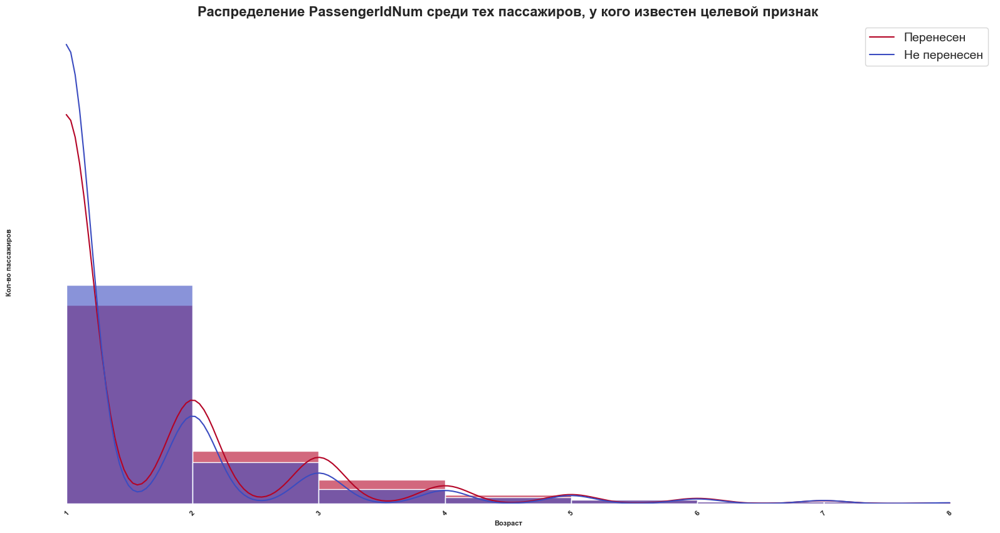

In [41]:
def plot_hist_with_target(df_: pd.DataFrame, col_: str) -> None:
    plt.figure(figsize=(20,10))

    # Histogram
    ax = sns.histplot(
        data=df_.sort_values(by=[col_]),
        x=col_,
        hue=target_col,
        binwidth=1,
        kde=True,
        palette="coolwarm",
        alpha=0.6
    )

    sns.despine(left=True, bottom=True)
    ax.set_facecolor("white")
    plt.grid(axis="y", alpha=0)
    plt.grid(axis="x", alpha=0)

    ax.set_yticklabels([])
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, fontsize=8, fontweight="bold")
    ax.set_xlabel(col_, fontsize=8, fontweight="bold")
    ax.set_ylabel("Кол-во пассажиров", fontsize=8, fontweight="bold")

    # Aesthetics
    plt.title(f"Распределение {col_} среди тех пассажиров, у кого известен целевой признак", fontsize=16, fontweight="bold")
    plt.xlabel("Возраст", fontsize=8, fontweight="bold")
    plt.ylabel("Кол-во пассажиров", fontsize=8, fontweight="bold")

    plt.legend(["Перенесен", "Не перенесен"], fontsize=14, loc="upper right")

    plt.show()


plot_hist_with_target(df, "PassengerIdNum")

В 71.5% групп - 1 пассажир. В 16.4% групп пассажиров не больше 2. В 12.1% групп пассажиров больше 2. В 1.5% групп пассажиров больше 5.

Выделим три группы:
1. -- 1 пассажир
2. -- от 2 до 6 пассажиров
3. -- 7 и более пассажиров

In [36]:
def add_passenger_id_group_num(df_: pd.DataFrame) -> pd.DataFrame:
    df_["PassengerIdNumGrouped"] = df_.PassengerIdNum.apply(lambda x: (1 if x == 1 else (3 if x >= 7 else 2)) if x else np.nan)
    return df_
    
df = add_passenger_id_group_num(df)
df.PassengerIdNumGrouped.value_counts()

PassengerIdNumGrouped
1    9280
2    3605
3      85
Name: count, dtype: int64

#### Cabin

---

Номер каюты, в которой находится пассажир. Имеет вид deck/num/side, где side может быть либо P - Port, либо S - Starboard.

Разделим этот столбец на три: **CabinDeck**, **CabinNum** и **CabinSide**:

In [37]:
def split_cabin(df_: pd.DataFrame) -> pd.DataFrame:
    df_[["CabinDeck", "CabinNum", "CabinSide"]] = df_.Cabin.str.split("/", expand=True)
    df_.drop(columns=["Cabin"], inplace=True)
    return df_


df = split_cabin(df)
df.head()

,HomePlanet,CryoSleep,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Name,Transported,PassengerIdGroup,PassengerIdNum,PassengerIdNumGrouped,CabinDeck,CabinNum,CabinSide
0,Europa,False,TRAPPIST-1e,39.0,False,0.0,0.0,0.0,0.0,0.0,Maham Ofracculy,False,1,1,1,B,0,P
1,Earth,False,TRAPPIST-1e,24.0,False,109.0,9.0,25.0,549.0,44.0,Juanna Vines,True,2,1,1,F,0,S
2,Europa,False,TRAPPIST-1e,58.0,True,43.0,3576.0,0.0,6715.0,49.0,Altark Susent,False,3,1,1,A,0,S
3,Europa,False,TRAPPIST-1e,33.0,False,0.0,1283.0,371.0,3329.0,193.0,Solam Susent,False,3,2,2,A,0,S
4,Earth,False,TRAPPIST-1e,16.0,False,303.0,70.0,151.0,565.0,2.0,Willy Santantines,True,4,1,1,F,1,S


Проверим зависимость номера каюты от расположения:

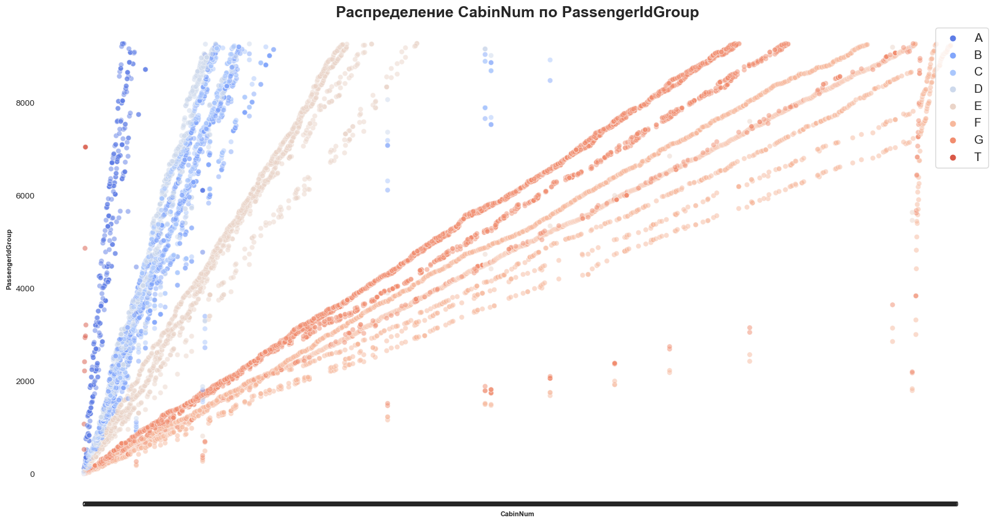

In [38]:
def plot_scatter(df_: pd.DataFrame, col_1_: str, col_2_: str, hue_: str) -> None:
  plt.figure(figsize=(20, 10))
  sns.scatterplot(
      x=df_[col_1_],
      y=df_[col_2_],
      hue=df_[hue_],
      hue_order=sorted(df_[hue_].unique()),
      palette="coolwarm",
      alpha=0.5
  )

  sns.despine(left=True, bottom=True)
  plt.grid(axis="y", alpha=0)
  plt.grid(axis="x", alpha=0)

  plt.title(f"Распределение {col_1_} по {col_2_}", fontsize=18, fontweight="bold")
  plt.xlabel(col_1_, fontsize=8, fontweight="bold")
  plt.ylabel(col_2_, fontsize=8, fontweight="bold")
  plt.xticks(fontsize=8, fontweight="bold")

  plt.legend(fontsize=14, loc="upper right")

  plt.show()

mask = df.CabinNum.notna() & df.PassengerIdGroup.notna() & df.CabinDeck.notna()
plot_scatter(df[mask], "CabinNum", "PassengerIdGroup", "CabinDeck")

Здесь есть интересная закономерность. Параметры **CabinNum** и **PassengerIdGroup** имеют линейную зависимость для каждой палубы. Поэтому мы можем экстраполировать недостающие номера кают, используя линейную регрессию для каждой палубы, чтобы получить приблизительное количество кают.

Посмотрим на распределение кол-ва пассажиров в группе в зависимости от палубы:

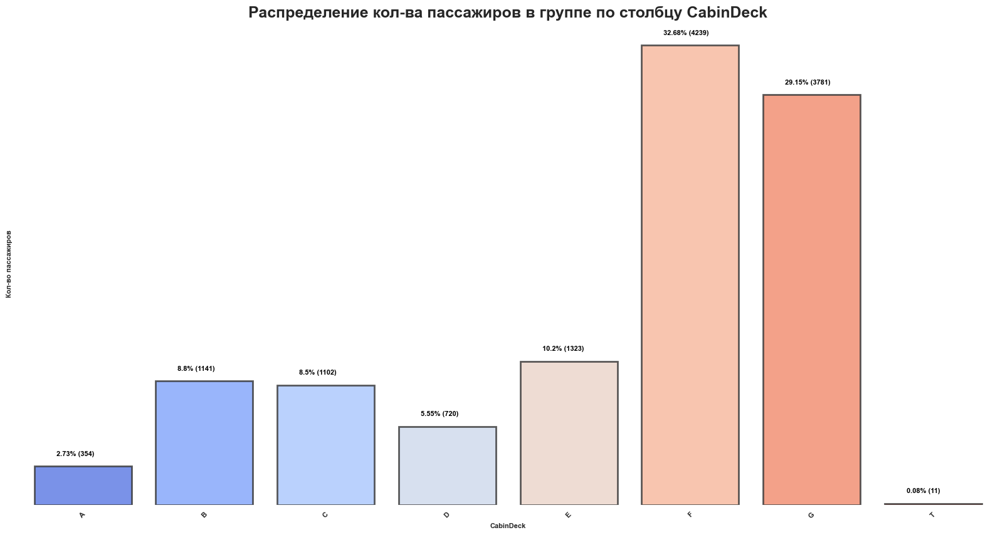

In [39]:
plot_dist(df, "CabinDeck", text_=True)

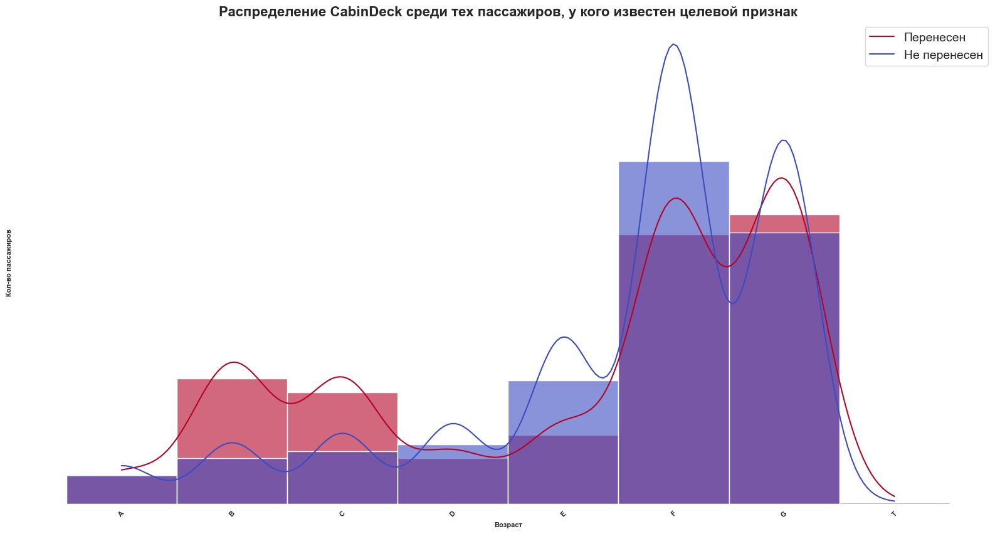

In [43]:
plot_hist_with_target(df, "CabinDeck")

Немногочисленная палуба T может быть, как выбросом, так и отдельным видом кают.

In [44]:
df[df.CabinDeck == "T"]

,HomePlanet,CryoSleep,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Name,Transported,PassengerIdGroup,PassengerIdNum,PassengerIdNumGrouped,CabinDeck,CabinNum,CabinSide
1004,NaN,False,TRAPPIST-1e,35.0,False,415.0,1328.0,0.0,14.0,60.0,Alraida Dingauge,False,1071,1,1,T,0,P
2254,Europa,False,TRAPPIST-1e,42.0,False,0.0,1829.0,2.0,3133.0,2447.0,Mergak Headfair,False,2414,1,1,T,1,P
2734,Europa,False,TRAPPIST-1e,33.0,False,0.0,28.0,0.0,6841.0,543.0,NaN,False,2935,1,1,T,2,P
2763,Europa,False,TRAPPIST-1e,38.0,False,0.0,3135.0,0.0,26.0,3.0,Pent Sessiouse,True,2971,1,1,T,3,P
4565,Europa,NaN,TRAPPIST-1e,37.0,False,1721.0,667.0,NaN,28.0,1362.0,Phacton Unsible,False,4863,1,1,T,2,S
8937,Europa,False,TRAPPIST-1e,35.0,False,0.0,6442.0,672.0,238.0,60.0,Tabius Frogauded,NaN,524,1,1,T,0,S
9744,Europa,False,TRAPPIST-1e,26.0,False,132.0,2576.0,0.0,2060.0,3.0,Alarmus Brantcable,NaN,2217,1,1,T,1,S
10187,Europa,False,TRAPPIST-1e,27.0,False,0.0,11293.0,0.0,297.0,4736.0,Thabius Reeddommy,NaN,3208,1,1,T,4,P
11904,Europa,False,55 Cancri e,27.0,NaN,6.0,400.0,0.0,6472.0,0.0,Tope Ativeezy,NaN,7046,1,1,T,3,S
11905,Europa,False,55 Cancri e,44.0,False,0.0,1190.0,0.0,1906.0,167.0,Genubih Ativeezy,NaN,7046,2,2,T,3,S


Скорее всего **CabineDeck**, **CabineNum** и **CabineSide** - это **Высота**, **Номер от начала** и **Сторона** каюты соответственно.
По этим трем осям можно определить положение каюты на корабле. Посмотрим, какие значения принимают эти признаки:

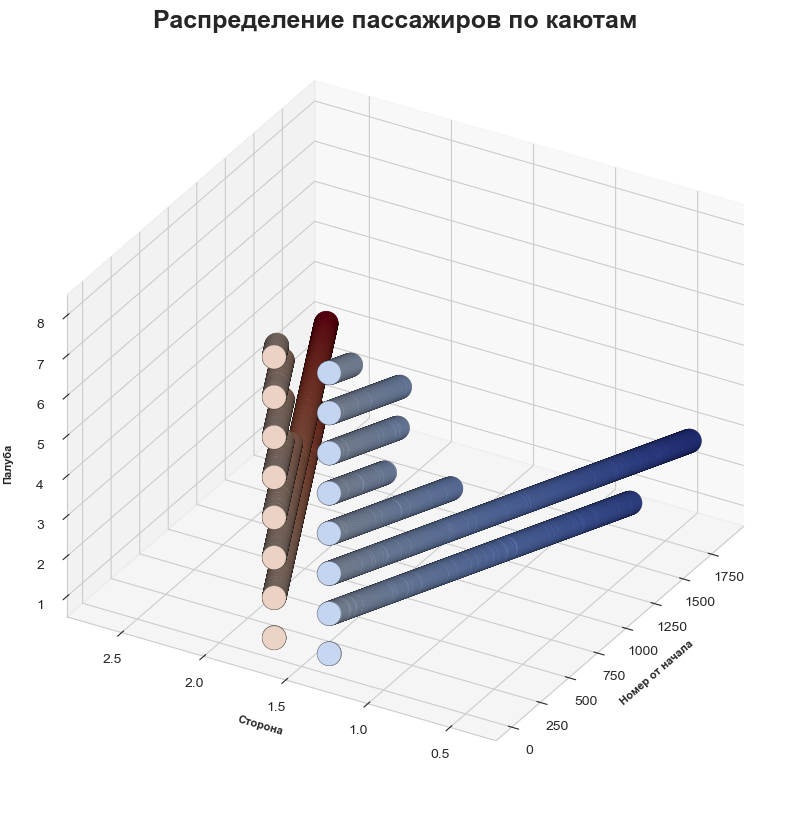

In [45]:
def plot_3d_simple_titanik(df_: pd.DataFrame, azim_: int = 210, elev_: int = 30) -> None:
    df_opt = df_.groupby(["CabinDeck", "CabinNum", "CabinSide"], as_index=False).size().reset_index()

    df_opt.CabinDeck = df_opt.CabinDeck.replace({"A": 8, "B": 7, "C": 6, "D": 5, "E": 4, "F": 3, "G": 2, "T": 1})
    df_opt.CabinNum = df_opt.CabinNum.astype(int) + 1
    df_opt.CabinSide = df_opt.CabinSide.replace({"P": 1, "S": 2})

    num_max = df_opt[df_opt.CabinSide == 1].CabinNum.max()
    df_opt.loc[df_opt.CabinSide == 1, "CabinSide"] = df_opt[df_opt.CabinSide == 1].CabinSide + (df_opt[df_opt.CabinSide == 1].CabinNum + num_max / 1.5) / num_max
    df_opt.loc[df_opt.CabinSide == 2, "CabinSide"] = df_opt[df_opt.CabinSide == 2].CabinSide - (df_opt[df_opt.CabinSide == 2].CabinNum + num_max / 1.5) / num_max


    plt.figure(figsize=(20, 10))

    ax = plt.axes(projection='3d', facecolor="white", frame_on=True, proj_type="ortho", azim=azim_, elev=elev_)

    ax.scatter3D(
        df_opt.CabinNum,
        df_opt.CabinSide,
        df_opt.CabinDeck,
        c=df_opt.CabinSide,
        s=300,
        alpha=0.5,
        linewidths=0.2,
        edgecolors="black",
        cmap="coolwarm"
    )

    ax.set_title("Распределение пассажиров по каютам", fontsize=18, fontweight="bold")
    ax.set_xlabel("Номер от начала", fontsize=8, fontweight="bold")
    ax.set_ylabel("Сторона", fontsize=8, fontweight="bold")
    ax.set_zlabel("Палуба", fontsize=8, fontweight="bold")

    plt.show()

mask = df.CabinDeck.notnull() & df.CabinNum.notnull() & df.CabinSide.notnull()
plot_3d_simple_titanik(df[mask])

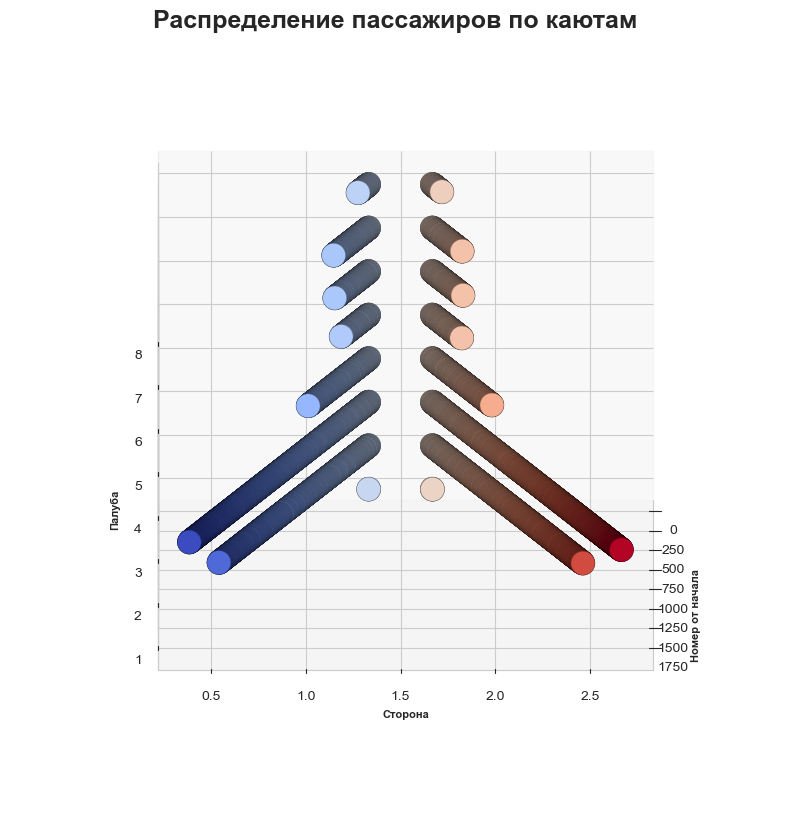

In [46]:
plot_3d_simple_titanik(df[mask], azim_=0, elev_=20)

Для визуального восприятия, мы дополнительно выделим тех, кто прибывал в криосне в отдельную группу (на уровень ниже тех, кто бодрствовал), увеличим размер точек в зависимости от возраста пассажира и окрасим их в зависимости от целевого признака. Так же, чем меньше номер каюты, тем ближе она к началу корабля (и сходится к середине).

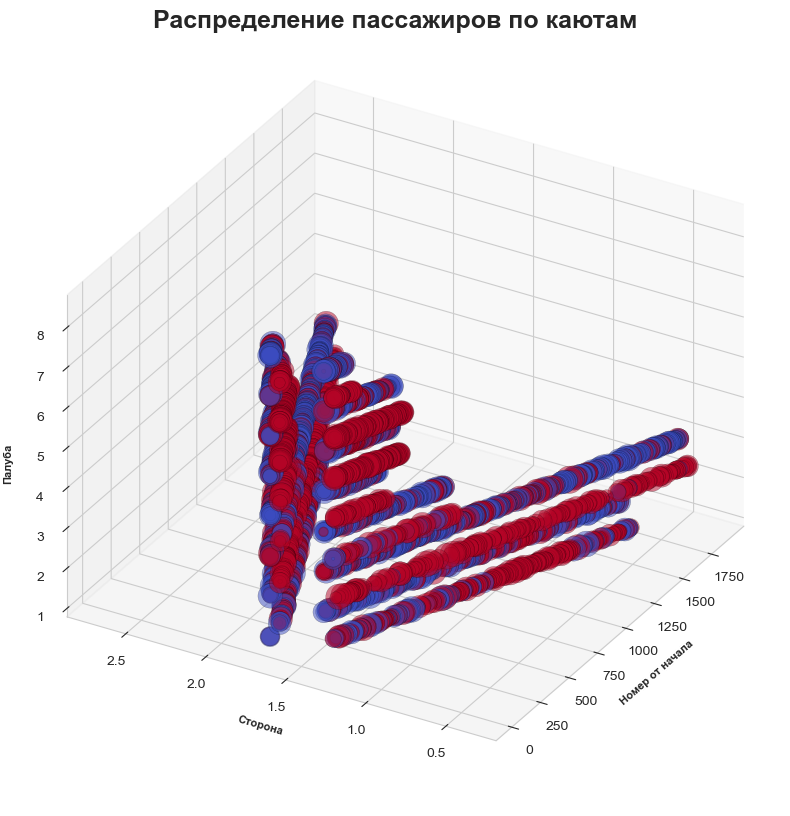

In [47]:
def plot_3d_titanik(df_: pd.DataFrame, azim_: int = 210, elev_: int = 30) -> None:
    df_opt = df_.groupby(["CabinDeck", "CabinNum", "CabinSide", target_col, "CryoSleep", "Age"], as_index=False).size().reset_index()

    df_opt.CabinDeck = df_opt.CabinDeck.replace({"A": 8, "B": 7, "C": 6, "D": 5, "E": 4, "F": 3, "G": 2, "T": 1})
    df_opt.CabinNum = df_opt.CabinNum.astype(int) + 1
    df_opt.CabinSide = df_opt.CabinSide.replace({"P": 1, "S": 2})

    num_max = df_opt[df_opt.CabinSide == 1].CabinNum.max()
    df_opt.loc[df_opt.CabinSide == 1, "CabinSide"] = df_opt[df_opt.CabinSide == 1].CabinSide + (df_opt[df_opt.CabinSide == 1].CabinNum + num_max / 1.5) / num_max
    df_opt.loc[df_opt.CabinSide == 2, "CabinSide"] = df_opt[df_opt.CabinSide == 2].CabinSide - (df_opt[df_opt.CabinSide == 2].CabinNum + num_max / 1.5) / num_max

    df_opt[target_col] = df_opt[target_col].replace({True: 1, False: 0})
    df_opt.CryoSleep = df_opt.CryoSleep.replace({True: -0.3, False: 0.3})

    df_opt.CabinSide = df_opt.CabinSide + (df_opt.CryoSleep / 10)
    df_opt.CabinDeck = df_opt.CabinDeck + df_opt.CryoSleep


    plt.figure(figsize=(20, 10))

    ax = plt.axes(projection='3d', facecolor="white", frame_on=True, proj_type="ortho", azim=azim_, elev=elev_)

    ax.scatter3D(
        df_opt.CabinNum,
        df_opt.CabinSide,
        df_opt.CabinDeck,
        c=df_opt[target_col],
        s=df_opt["Age"] + (4 * df_opt["Age"]),
        alpha=0.5,
        linewidths=0.2,
        edgecolors="black",
        cmap="coolwarm"
    )

    ax.set_title("Распределение пассажиров по каютам", fontsize=18, fontweight="bold")
    ax.set_xlabel("Номер от начала", fontsize=8, fontweight="bold")
    ax.set_ylabel("Сторона", fontsize=8, fontweight="bold")
    ax.set_zlabel("Палуба", fontsize=8, fontweight="bold")

    plt.show()

mask = df.CabinDeck.notnull() & df.CabinNum.notnull() & df.CabinSide.notnull() & df[target_col].notnull() & df.CryoSleep.notnull()
plot_3d_titanik(df[mask])

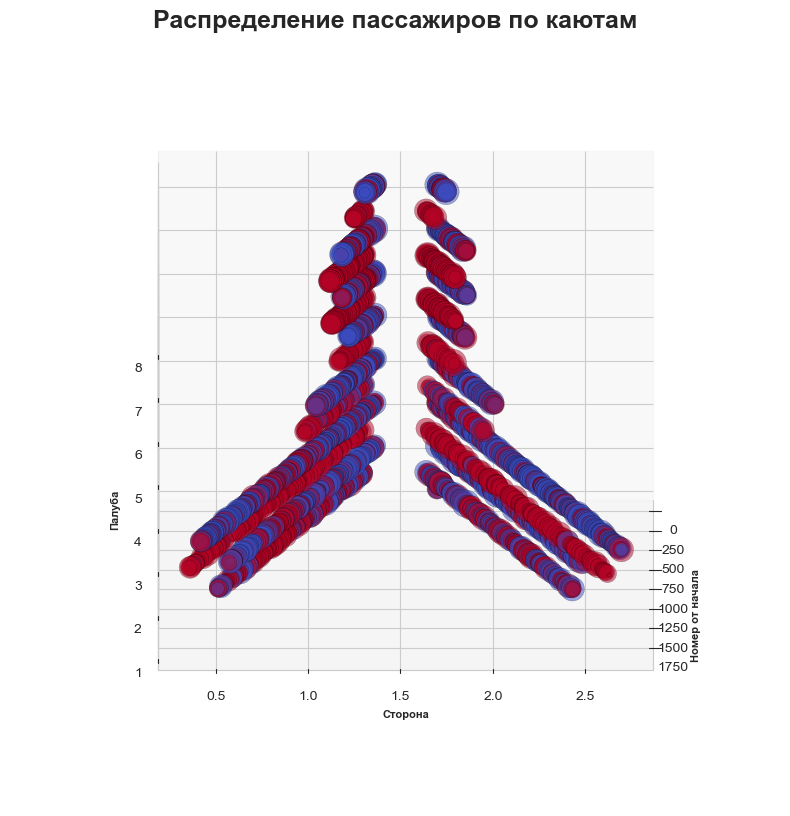

In [48]:
plot_3d_titanik(df[mask], azim_=0, elev_=20)

#### Name

---

Проверим, сколько пассажиров в каждой из созданных групп похожи (являются родственниками или живут/направляются на одну и ту же планету).

Для этого дополнительно преобразуем столбец **Name** в **LastName** и **FirstName**.

In [49]:
np.mean([len(i) for i in df.Name.str.split(" ").values if isinstance(i, list)])

2.0

Как видим, у всех имена состоят из двух слов. Заполним пропуски в столбце **Name** значением **Unknown Unknown** и разделим их на два столбца:

In [50]:
def split_name(df_: pd.DataFrame) -> pd.DataFrame:
    df_.Name.fillna("Unknown Unknown", inplace=True)
    df_["FirstName"] = df_.Name.str.split(" ").str[1].str.strip().str.lower()
    df_["LastName"] = df_.Name.str.split(" ").str[0].str.strip().str.lower()

    df_.drop("Name", axis=1, inplace=True)

    return df_


df = split_name(df)
df.head()

,HomePlanet,CryoSleep,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Transported,PassengerIdGroup,PassengerIdNum,PassengerIdNumGrouped,CabinDeck,CabinNum,CabinSide,FirstName,LastName
0,Europa,False,TRAPPIST-1e,39.0,False,0.0,0.0,0.0,0.0,0.0,False,1,1,1,B,0,P,ofracculy,maham
1,Earth,False,TRAPPIST-1e,24.0,False,109.0,9.0,25.0,549.0,44.0,True,2,1,1,F,0,S,vines,juanna
2,Europa,False,TRAPPIST-1e,58.0,True,43.0,3576.0,0.0,6715.0,49.0,False,3,1,1,A,0,S,susent,altark
3,Europa,False,TRAPPIST-1e,33.0,False,0.0,1283.0,371.0,3329.0,193.0,False,3,2,2,A,0,S,susent,solam
4,Earth,False,TRAPPIST-1e,16.0,False,303.0,70.0,151.0,565.0,2.0,True,4,1,1,F,1,S,santantines,willy


#### HomePlanet

---

Планета, с которой пассажир вылетел, обычно это планета его постоянного проживания.

В столбце 3 уникальных значения:
1. **Earth** - Земля
2. **Europa** - Европа (спутник Юпитера)
3. **Mars** - Марс

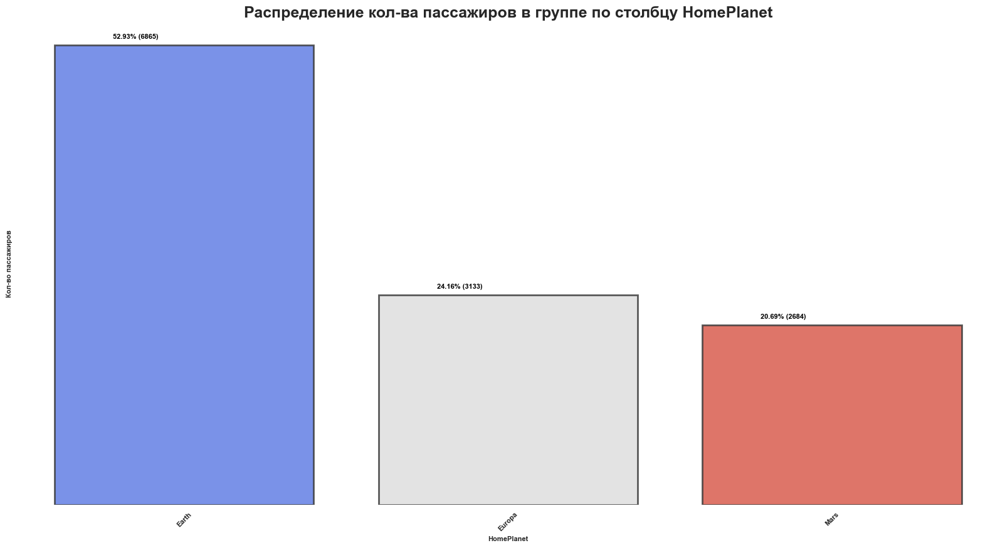

In [51]:
plot_dist(df, "HomePlanet", text_=True)

Видим, что больше половины пассажиров вылетели с Земли _(52.93%)_. Проверим гипотезу о том, что пассажиры в группе с одной планеты:

In [52]:
df_home_planet_grouped = df[(df.PassengerIdNumGrouped > 1)].groupby(["HomePlanet"], as_index=False).PassengerIdGroup.nunique()
df_home_planet_grouped.columns = ["HomePlanet", "PassengerIdGroupCount"]

df_home_planet_grouped.PassengerIdGroupCount.value_counts()

PassengerIdGroupCount
799    1
782    1
523    1
Name: count, dtype: int64

Так и есть. Это означает, что мы можем восстановить значение родной планеты всем, у кого известна группа.

#### Destination

---

Планета, на которой пассажир будет высаживаться.

В столбце 3 уникальных значения:

1. **55 Cancri e** - экзопланета, вращающаяся вокруг звезды 55 Канкри, находящейся в созвездии Рака на расстоянии 40 световых лет от Земли.
2. **TRAPPIST-1e** - экзопланета, вращающаяся вокруг звезды TRAPPIST-1, находящейся в созвездии Водолея на расстоянии 39 световых лет от Земли.
3. **PSO J318.5-22** - экзопланета, вращающаяся вокруг коричневого карлика PSO J318.5-22, находящегося в созвездии Живописца на расстоянии 80 световых лет от Земли.

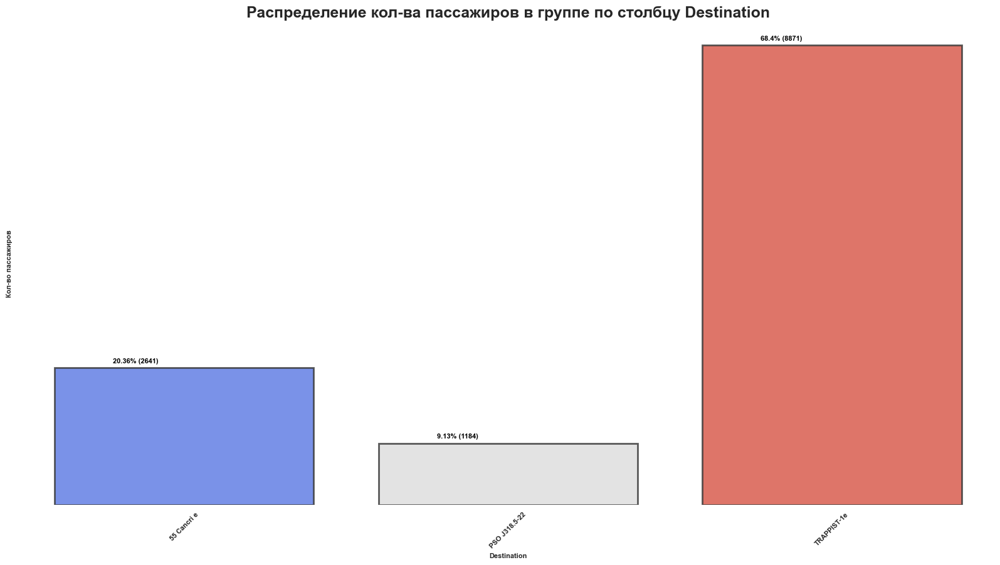

In [53]:
plot_dist(df, "Destination", text_=True)

Объединим родные планеты пассажиров с планетами, на которые они направляются:

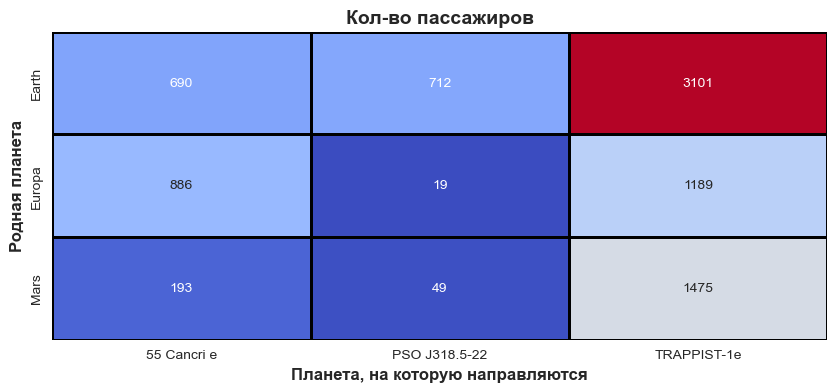

In [56]:
def plot_heat_map(df_: pd.DataFrame) -> None:
    planet_des = df_.groupby(["HomePlanet", "Destination"])["Destination"].size().unstack().fillna(0)

    plt.figure(figsize=(10,4))

    sns.heatmap(
        planet_des,
        annot=True,
        fmt="g",
        cmap="coolwarm",
        linewidths=1,
        linecolor="black",
        cbar=False
    )

    plt.title("Кол-во пассажиров", fontsize=14, fontweight="bold")
    plt.xlabel("Планета, на которую направляются", fontsize=12, fontweight="bold")
    plt.ylabel("Родная планета", fontsize=12, fontweight="bold")

    plt.show()

plot_heat_map(df_train)

1. Видим, что пассажиры с Земли чаще всего направляются на экзопланету **TRAPPIST-1e**. А так же, я вляются самыми частыми и практически единственными посетителями экзопланеты **PSO J318.5-22**.

2. Пассажиры с Европы чаще всего направляются на экзопланету **TRAPPIST-1e**. И, по анологии с землянами, являются самыми частыми посетителями экзопланеты **55 Cancri e**.

3. Пассажиры с Марса в очень редких случаях направляются на экзопланету **55 Cancri e**. В основном поток пассажиров с Европы направляется на экзопланету **TRAPPIST-1e**.

**Кого перенесло в альтернативное измерение?**

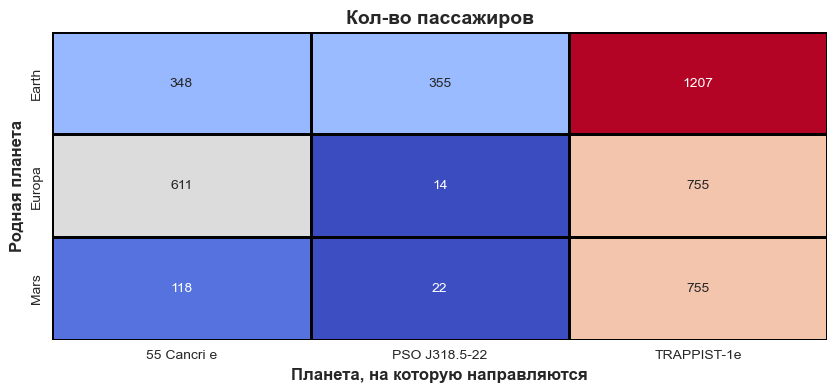

In [55]:
plot_heat_map(df_train[df_train[target_col] == True])

**Кого не переносло в альтернативное измерение?**

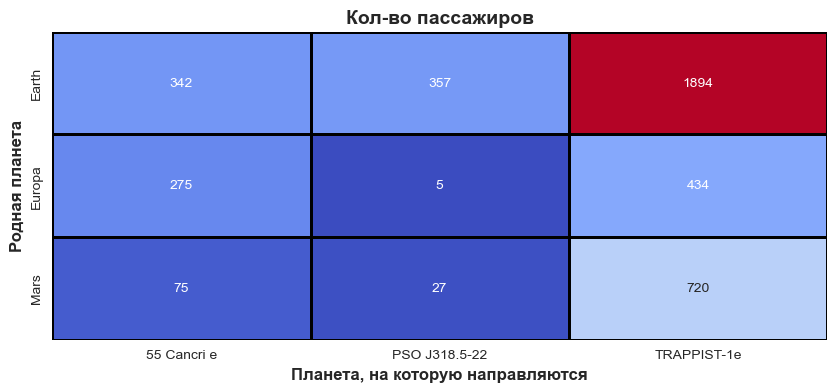

In [57]:
plot_heat_map(df_train[df_train[target_col] == False])

Посмотрим на 3D-распределение пассажиров по кораблю в зависимости от родной планеты и планеты, на которую они направляются. Начиная с Земли, заканчивая Марсом, меняется размер точек от меньшего к большему. Начиная с **55 Cancri e**, заканчивая **PSO J318.5-22**, меняется цвет точек от синего к красному.

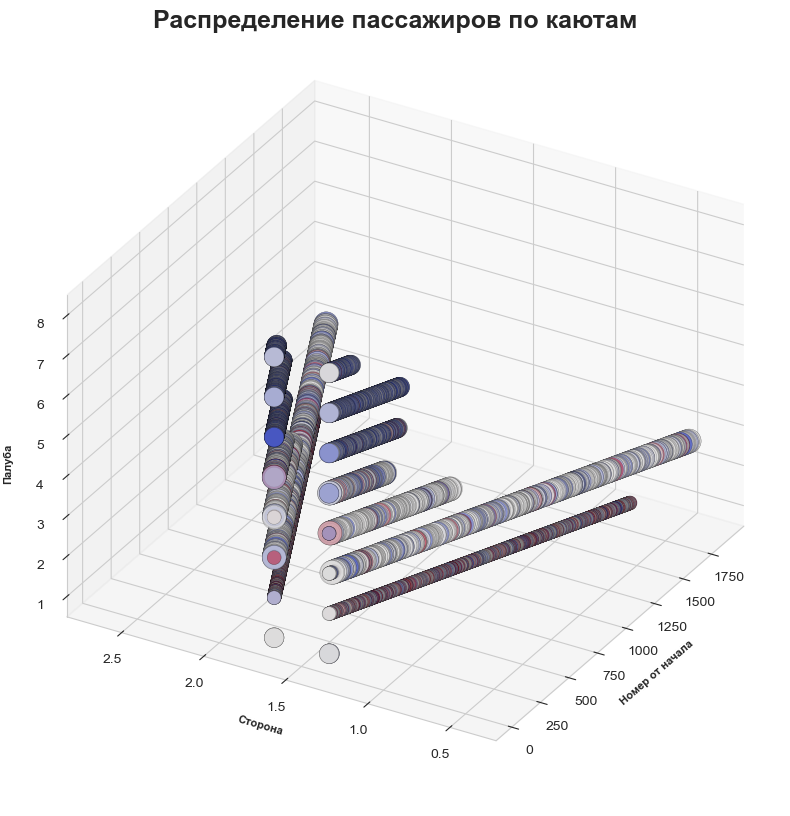

In [58]:
def plot_3d_titanik_with_planet(df_: pd.DataFrame, azim_: int = 210, elev_: int = 30) -> None:
    df_opt = df_.groupby(["CabinDeck", "CabinNum", "CabinSide", "HomePlanet", "Destination"], as_index=False).size().reset_index()

    df_opt.CabinDeck = df_opt.CabinDeck.replace({"A": 8, "B": 7, "C": 6, "D": 5, "E": 4, "F": 3, "G": 2, "T": 1})
    df_opt.CabinNum = df_opt.CabinNum.astype(int) + 1
    df_opt.CabinSide = df_opt.CabinSide.replace({"P": 1, "S": 2})

    df_opt.HomePlanet = df_opt.HomePlanet.replace({"Earth": 1, "Europa": 2, "Mars": 3})
    df_opt.Destination = df_opt.Destination.replace({"55 Cancri e": 1, "TRAPPIST-1e": 2, "PSO J318.5-22": 3})

    df_opt["HomeToDest"] = df_opt.HomePlanet + df_opt.Destination

    num_max = df_opt[df_opt.CabinSide == 1].CabinNum.max()
    df_opt.loc[df_opt.CabinSide == 1, "CabinSide"] = df_opt[df_opt.CabinSide == 1].CabinSide + (df_opt[df_opt.CabinSide == 1].CabinNum + num_max / 1.5) / num_max
    df_opt.loc[df_opt.CabinSide == 2, "CabinSide"] = df_opt[df_opt.CabinSide == 2].CabinSide - (df_opt[df_opt.CabinSide == 2].CabinNum + num_max / 1.5) / num_max


    plt.figure(figsize=(20, 10))

    ax = plt.axes(projection='3d', facecolor="white", frame_on=True, proj_type="ortho", azim=azim_, elev=elev_)

    ax.scatter3D(
        df_opt.CabinNum,
        df_opt.CabinSide,
        df_opt.CabinDeck,
        c=df_opt.Destination,
        s=100 * df_opt.HomePlanet,
        alpha=0.5,
        linewidths=0.2,
        edgecolors="black",
        cmap="coolwarm"
    )

    ax.set_title("Распределение пассажиров по каютам", fontsize=18, fontweight="bold")
    ax.set_xlabel("Номер от начала", fontsize=8, fontweight="bold")
    ax.set_ylabel("Сторона", fontsize=8, fontweight="bold")
    ax.set_zlabel("Палуба", fontsize=8, fontweight="bold")

    plt.show()

mask = df.CabinDeck.notnull() & df.CabinNum.notnull() & df.CabinSide.notnull() & (df.HomePlanet.notnull()) & (df.Destination.notnull())
plot_3d_titanik_with_planet(df[mask])

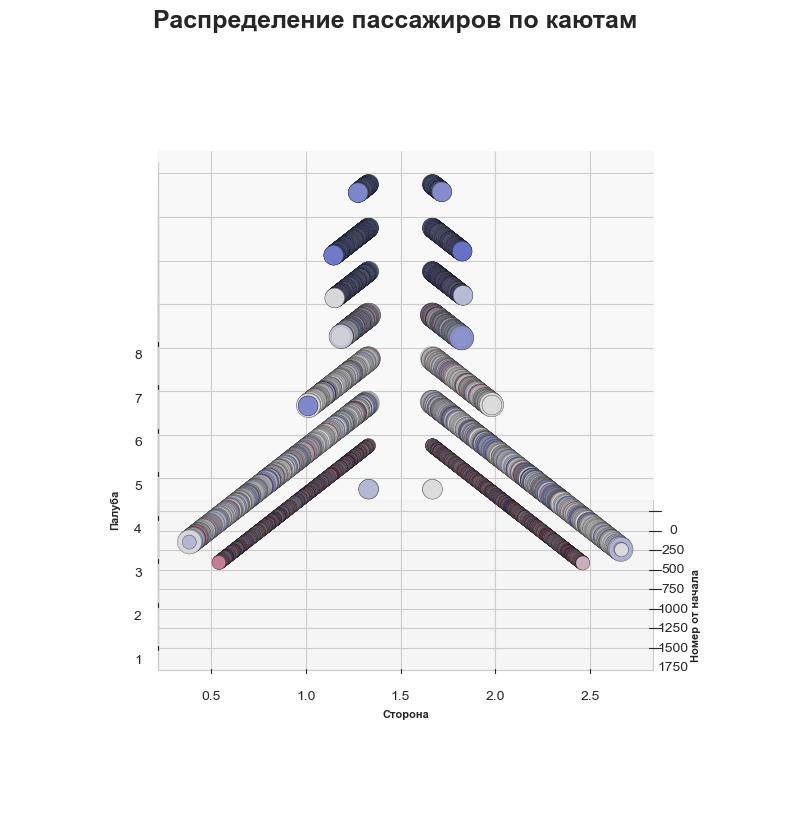

In [59]:
plot_3d_titanik_with_planet(df[mask], azim_=0, elev_=20)

### Бинарные признаки

---

#### VIP

---

Оплатил ли пассажир специальное VIP-обслуживание во время рейса.

В столбце 2 уникальных значения:

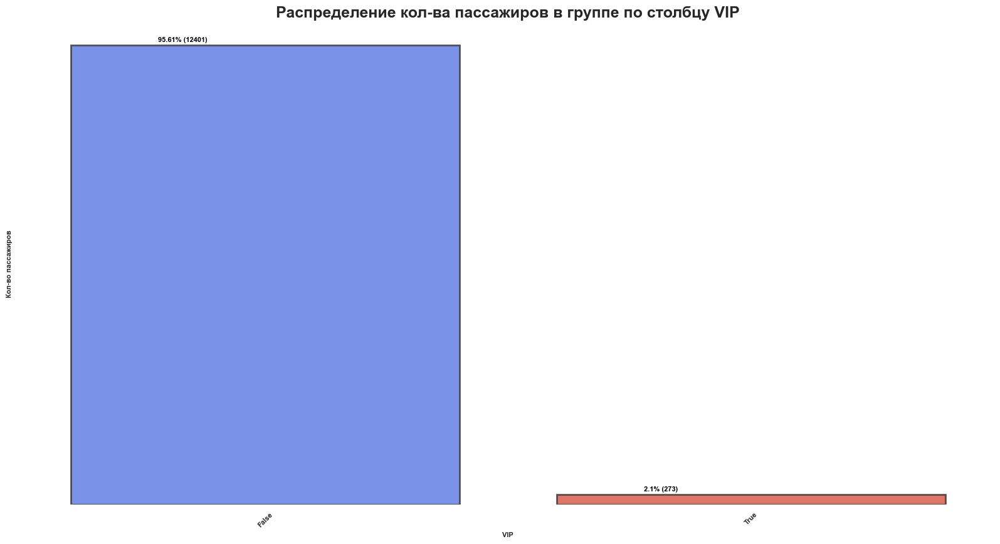

In [60]:
plot_dist(df, "VIP", text_=True)

Всего 273 пассажира оплатили VIP-обслуживание. Посмотрим, откуда и куда они направлялись:

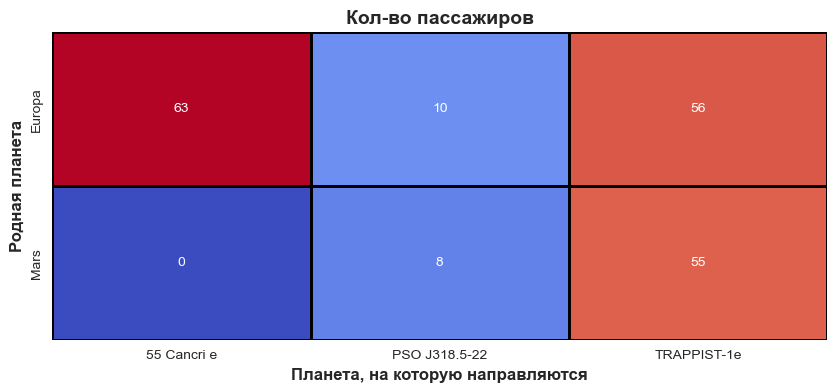

In [61]:
plot_heat_map(df_train[df_train["VIP"] == True])

Интересно, что нет ни одного пассажира с **VIP**-статусом. Это может помочь с восстановлением данных.

Посмотрим, помог ли **VIP**-статус пассажиру не попасть в альтернативное измерение:

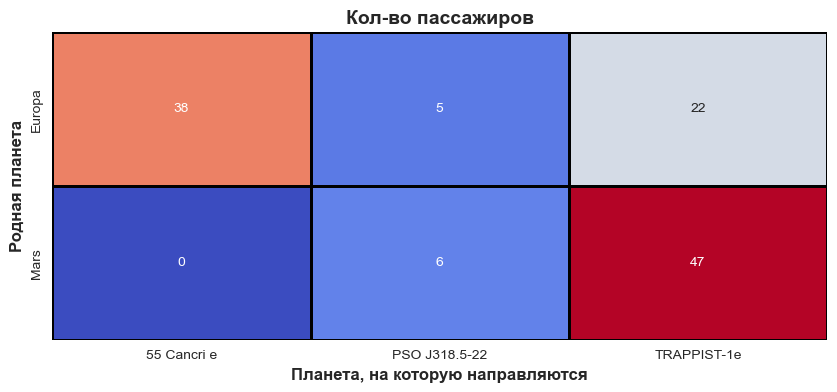

In [62]:
plot_heat_map(df_train[df_train["VIP"] == True][df_train[target_col] == False])

Судя по немногочисленным данным, **VIP**-статус мог "помочь" только пассажирам с Марса.

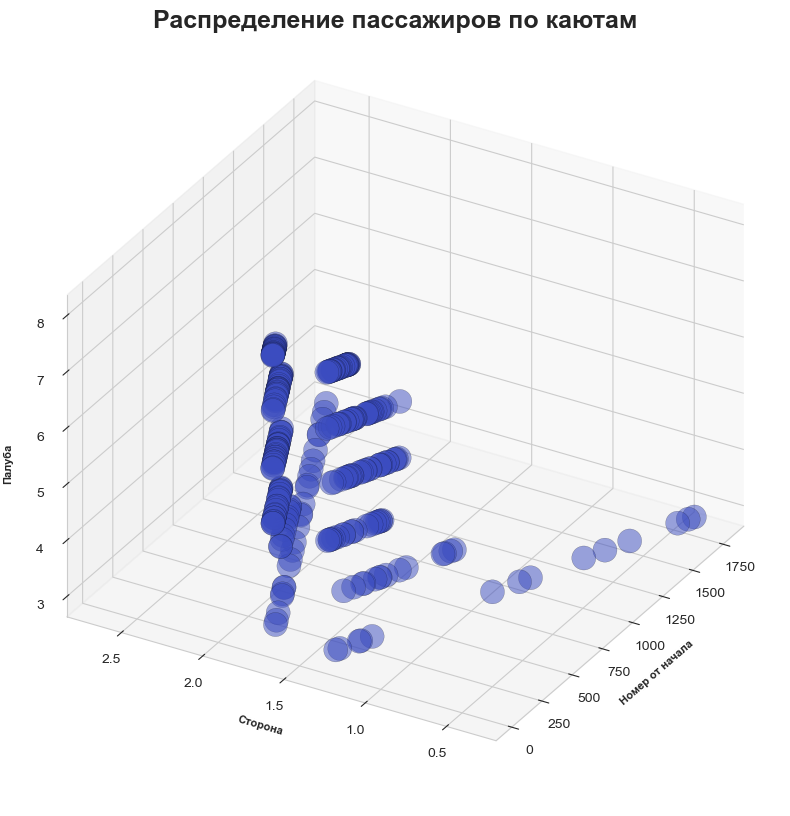

In [63]:
def plot_3d_titanik_with_col(df_: pd.DataFrame, col_: str, azim_: int = 210, elev_: int = 30) -> None:
    df_opt = df_.groupby(["CabinDeck", "CabinNum", "CabinSide", col_], as_index=False).size().reset_index()

    df_opt.CabinDeck = df_opt.CabinDeck.replace({"A": 8, "B": 7, "C": 6, "D": 5, "E": 4, "F": 3, "G": 2, "T": 1})
    df_opt.CabinNum = df_opt.CabinNum.astype(int) + 1
    df_opt.CabinSide = df_opt.CabinSide.replace({"P": 1, "S": 2})

    num_max = df_opt[df_opt.CabinSide == 1].CabinNum.max()
    df_opt.loc[df_opt.CabinSide == 1, "CabinSide"] = df_opt[df_opt.CabinSide == 1].CabinSide + (df_opt[df_opt.CabinSide == 1].CabinNum + num_max / 1.5) / num_max
    df_opt.loc[df_opt.CabinSide == 2, "CabinSide"] = df_opt[df_opt.CabinSide == 2].CabinSide - (df_opt[df_opt.CabinSide == 2].CabinNum + num_max / 1.5) / num_max


    plt.figure(figsize=(20, 10))

    ax = plt.axes(projection='3d', facecolor="white", frame_on=True, proj_type="ortho", azim=azim_, elev=elev_)

    ax.scatter3D(
        df_opt.CabinNum,
        df_opt.CabinSide,
        df_opt.CabinDeck,
        c=df_opt[col_],
        s=300,
        alpha=0.5,
        linewidths=0.2,
        edgecolors="black",
        cmap="coolwarm"
    )

    ax.set_title("Распределение пассажиров по каютам", fontsize=18, fontweight="bold")
    ax.set_xlabel("Номер от начала", fontsize=8, fontweight="bold")
    ax.set_ylabel("Сторона", fontsize=8, fontweight="bold")
    ax.set_zlabel("Палуба", fontsize=8, fontweight="bold")

    plt.show()

mask = df.CabinDeck.notnull() & df.CabinNum.notnull() & df.CabinSide.notnull() & df.VIP.notnull() & (df.VIP == True)
plot_3d_titanik_with_col(df[mask], "VIP")

Большинство пассажиров с **VIP**-статусом находились на верхних палубах и ближе к началу корабля.

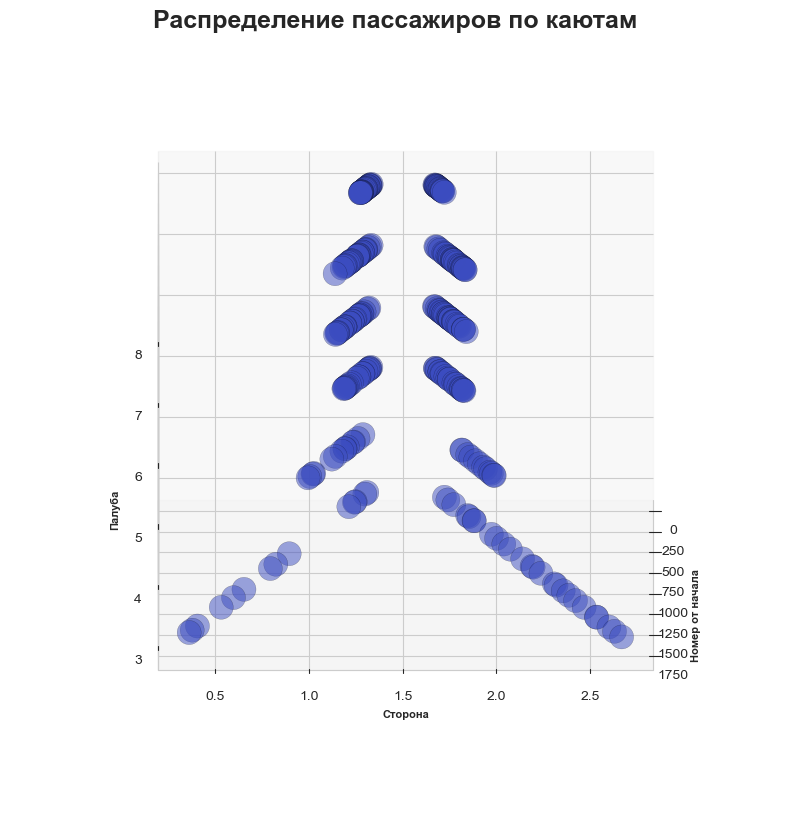

In [64]:
plot_3d_titanik_with_col(df[mask], "VIP", azim_=0, elev_=20)

#### CryoSleep

---

Указывает, желает ли пассажир быть переведенным в состояние условной анимации на время путешествия. _Пассажиры, находящиеся в криосне, находятся в своих каютах._

В столбце 2 уникальных значения:

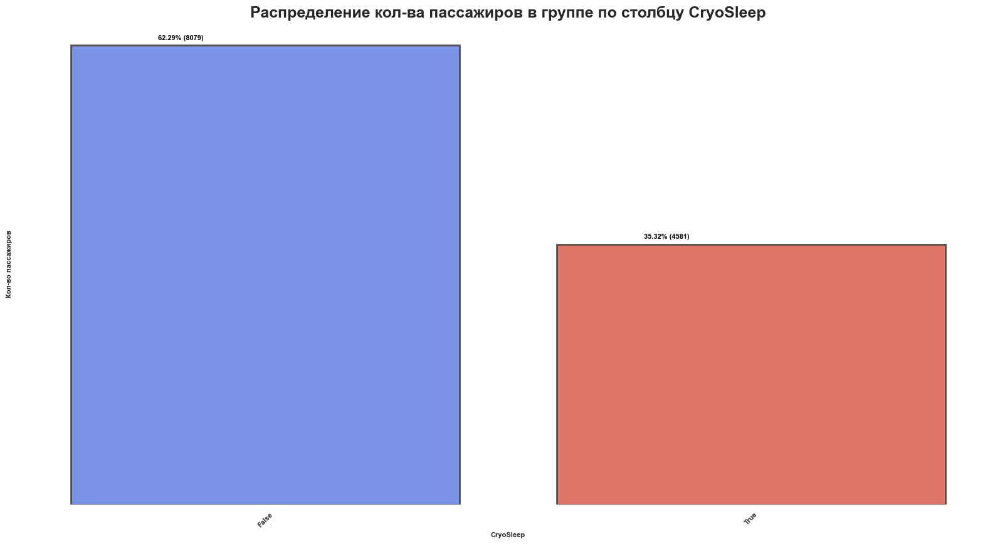

In [65]:
plot_dist(df, "CryoSleep", text_=True)

35.32% пассажиров были переведены в состояние условной анимации на время путешествия. Посмотрим, откуда и куда они направлялись:

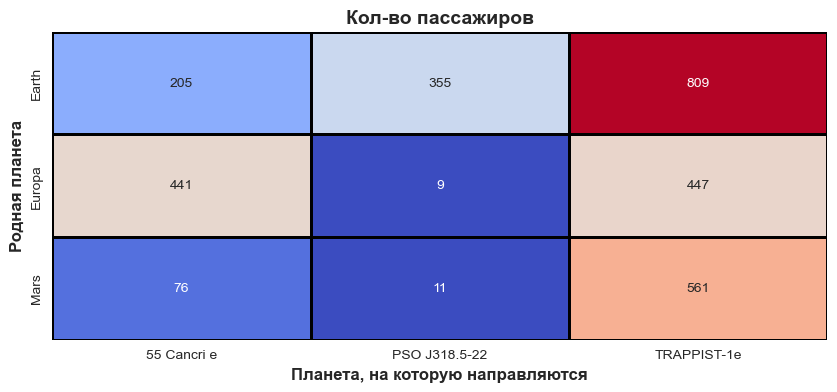

In [66]:
plot_heat_map(df_train[df_train["CryoSleep"] == True])

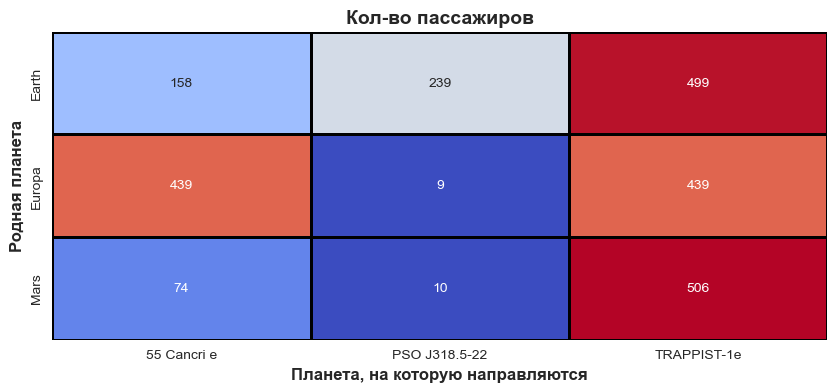

In [67]:
plot_heat_map(df_train[df_train["CryoSleep"] == True][df_train[target_col] == True])

Видим, что криосон стал чуть ли не гарантией того, что пассажир попадет в альтернативное измерение.

Сравним их с теми, кто не был переведен в состояние условной анимации на время путешествия:

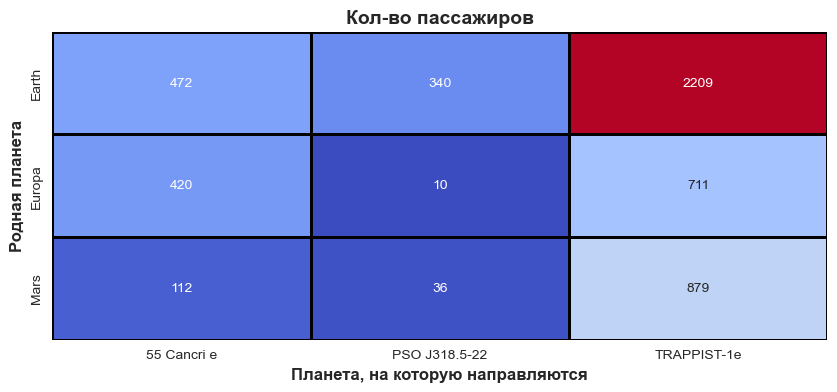

In [68]:
plot_heat_map(df_train[df_train["CryoSleep"] == False])

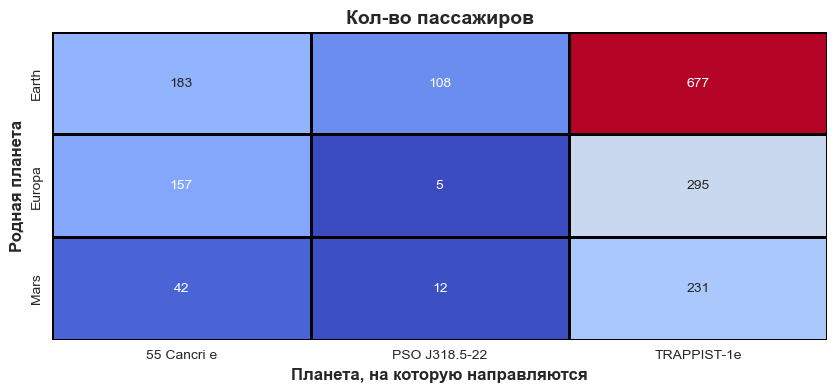

In [69]:
plot_heat_map(df_train[df_train["CryoSleep"] == False][df_train[target_col] == True])

Бодруствующие пассажиры с любой планеты имели 2/3 шанса не попасть в альтернативное измерение.

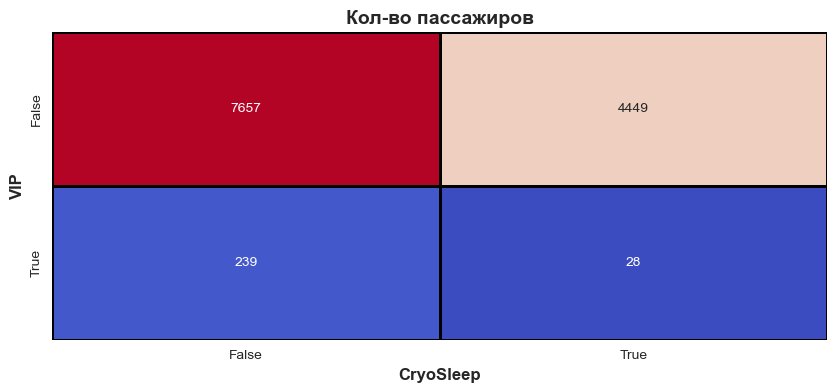

In [70]:
def plot_heat_map_with_col(df_: pd.DataFrame, col_1_: str, col_2_) -> None:
    planet_des = df_.groupby([col_1_, col_2_])["Destination"].size().unstack().fillna(0)

    plt.figure(figsize=(10,4))

    sns.heatmap(
        planet_des,
        annot=True,
        fmt="g",
        cmap="coolwarm",
        linewidths=1,
        linecolor="black",
        cbar=False
    )

    plt.title("Кол-во пассажиров", fontsize=14, fontweight="bold")
    plt.xlabel(f"{col_2_}", fontsize=12, fontweight="bold")
    plt.ylabel(f"{col_1_}", fontsize=12, fontweight="bold")

    plt.show()


plot_heat_map_with_col(df, "VIP", "CryoSleep")

Проверим расположение спящих пассажиров на корабле:

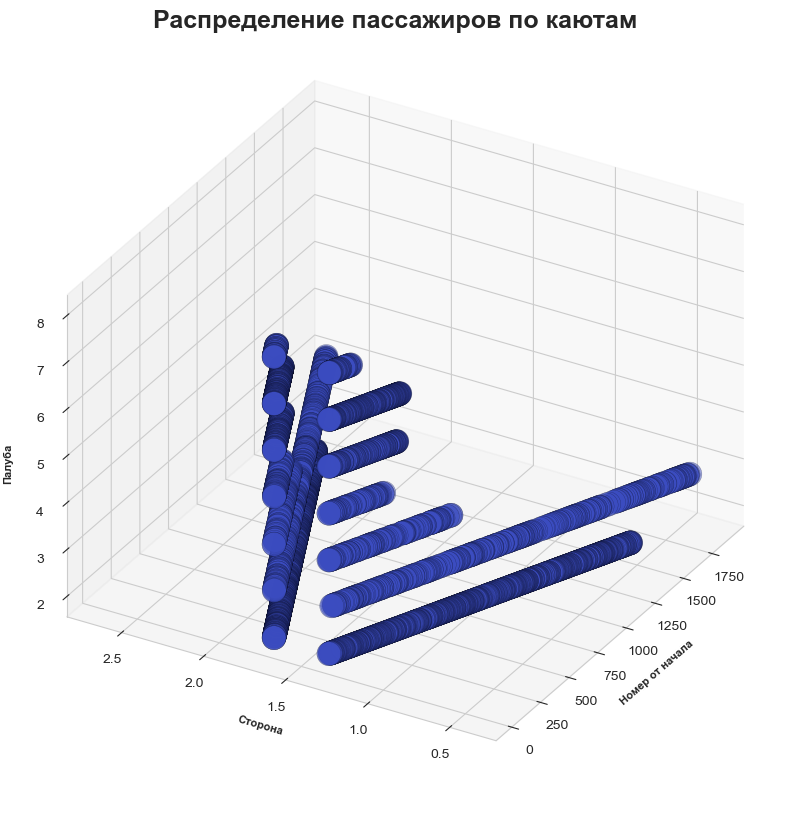

In [71]:
mask = df.CabinDeck.notnull() & df.CabinNum.notnull() & df.CabinSide.notnull() & (df.CryoSleep.notnull()) & (df.CryoSleep == True)
plot_3d_titanik_with_col(df[mask], "CryoSleep")

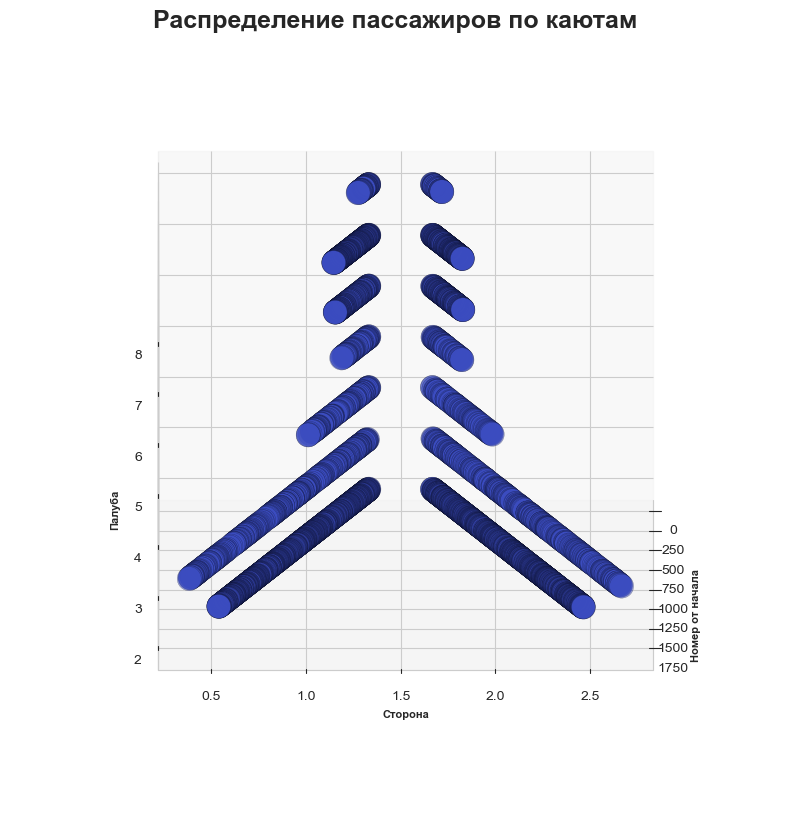

In [72]:
plot_3d_titanik_with_col(df[mask], "CryoSleep", azim_=0, elev_=20)

Проверим зависимость между родной планетой и палубой, на которой находился пассажир:

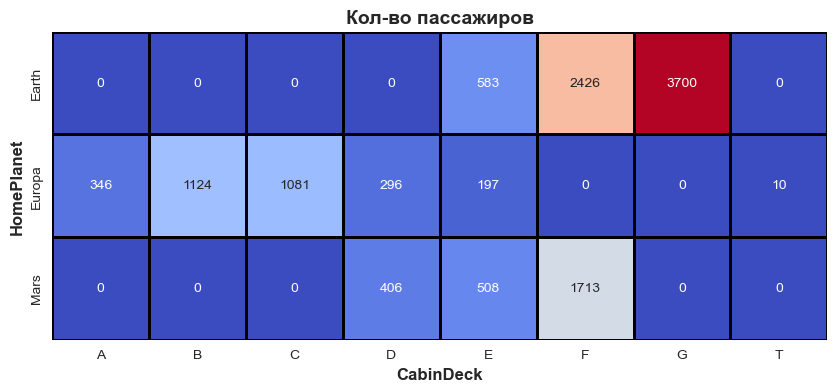

In [73]:
plot_heat_map_with_col(df, "HomePlanet", "CabinDeck")

* Пассажиры на палубах **A**, **B**, **C** или **T** прибыли с планеты Европа
* Пассажиры на палубе **G** прибыли с Земли
* Пассажиры на палубах **D** с Европы или Марса
* Пассажиры на палубах **F** с Земли или Марса
* Пассажиры на палубах **E** со всех планет

Проверим зависимость между планетой, на которую направляется пассажир, и палубой, на которой он находился:

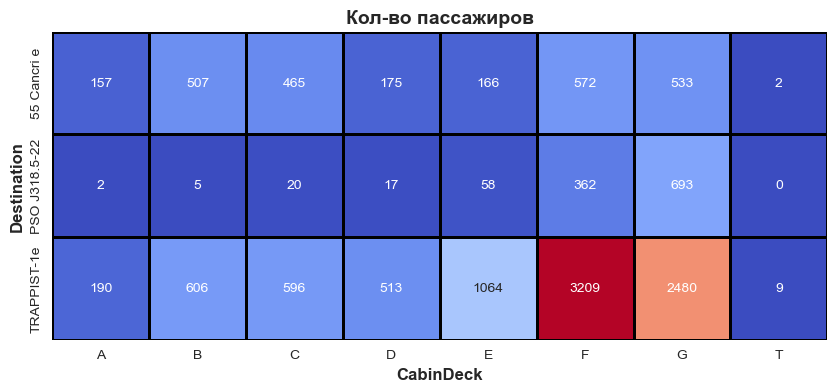

In [74]:
plot_heat_map_with_col(df, "Destination", "CabinDeck")

Посмотрим те же зависимости, но для стороны корабля:

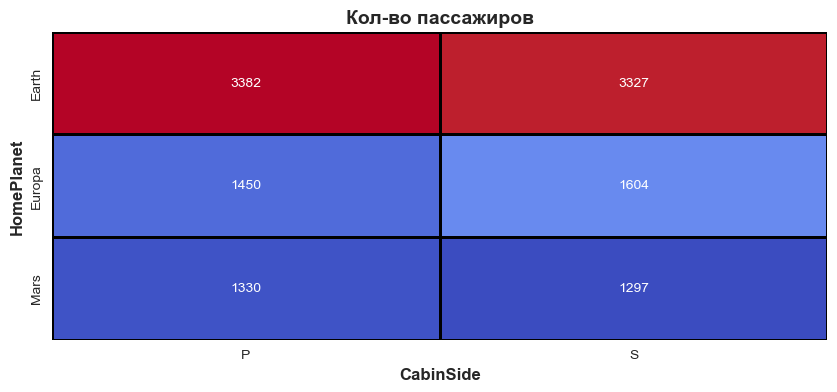

In [75]:
plot_heat_map_with_col(df, "HomePlanet", "CabinSide")

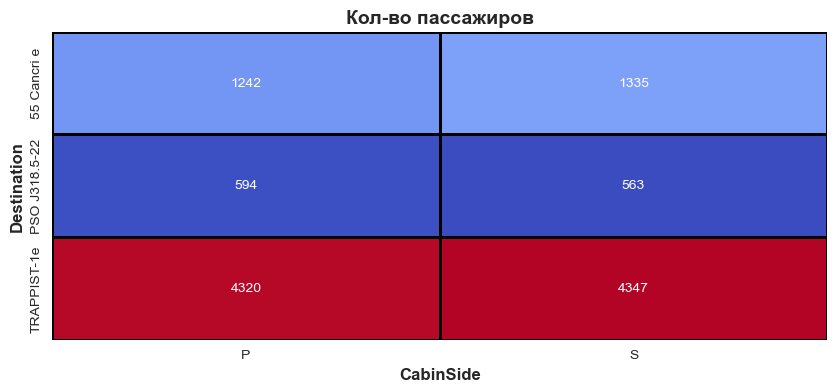

In [76]:
plot_heat_map_with_col(df, "Destination", "CabinSide")

В данном случае, чеикой зависимости не видно.

Проверим зависимость от фамилии:

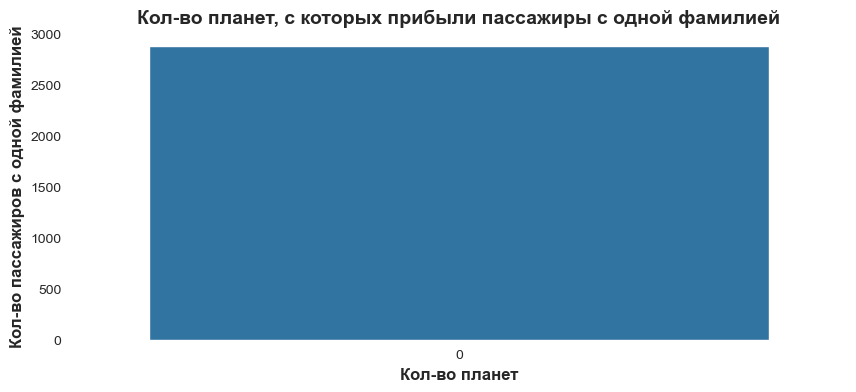

In [77]:
df_lastname_group = df.groupby(["LastName", "HomePlanet"])["HomePlanet"].size().unstack().fillna(0)

plt.figure(figsize=(10,4))

ax = sns.countplot((df_lastname_group > 0).sum(axis=1))

sns.despine(left=True, bottom=True)
ax.set_facecolor("white")
plt.grid(axis="y", alpha=0)
plt.grid(axis="x", alpha=0)

plt.title("Кол-во планет, с которых прибыли пассажиры с одной фамилией", fontsize=14, fontweight="bold")
plt.xlabel("Кол-во планет", fontsize=12, fontweight="bold")
plt.ylabel("Кол-во пассажиров с одной фамилией", fontsize=12, fontweight="bold")

plt.show()

Люди с одной и той же фамилией прибыли с одной планеты. Можем использовать это для восстановления данных.

---


**Небольшие выводы:**

* Пассажиры, прибывшие из Европы и Марса, имеют больше не перенестись в альтернативное измерение, чем пассажиры, прибывшие с Земли
* Люди, находящиеся в криогенном сне, имеют больше шансов быть перенесенными, чем те, кто этого не делал
* Большинство людей летят на TRAPPIST-1e, а затем на 55 Cancri e
* Большинство перевозимых людей не были VIP
* Пассажиры, путешествующие в группе, имеют больше шансов быть перевезенными
* Люди с одной и той же фамилией прибыли с одной планеты
* Существует зависимость между планетой, с которой прибыл пассажир, и палубой, на которой он находился
* Линейная зависимость между номером каюты и номером группы

### Числовые признаки

---

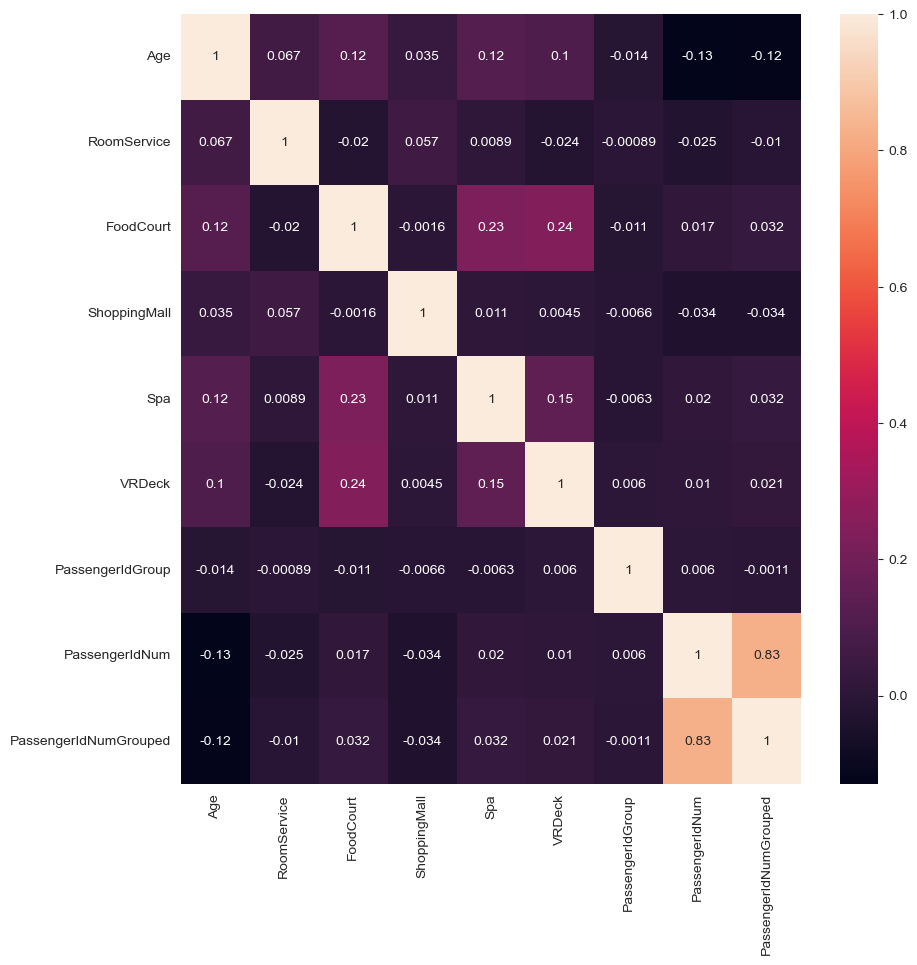

In [78]:
def plot_corr(df_: pd.DataFrame) -> None:
    corr = df_[df_.dtypes[df.dtypes != "object"].index].corr(method="pearson")
    plt.figure(figsize=(10,10))
    sns.heatmap(corr, annot=True)
    plt.show()

plot_corr(df)

#### Age

---

Возраст пассажира.

In [79]:
df.Age.describe()

count    12700.000000
mean        28.771969
std         14.387261
min          0.000000
25%         19.000000
50%         27.000000
75%         38.000000
max         79.000000
Name: Age, dtype: float64

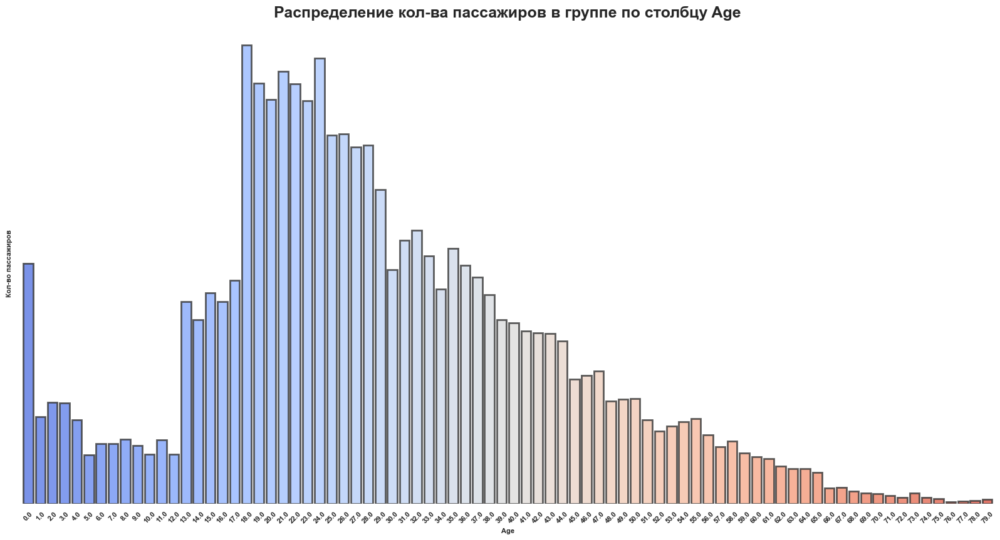

In [80]:
plot_dist(df, "Age")

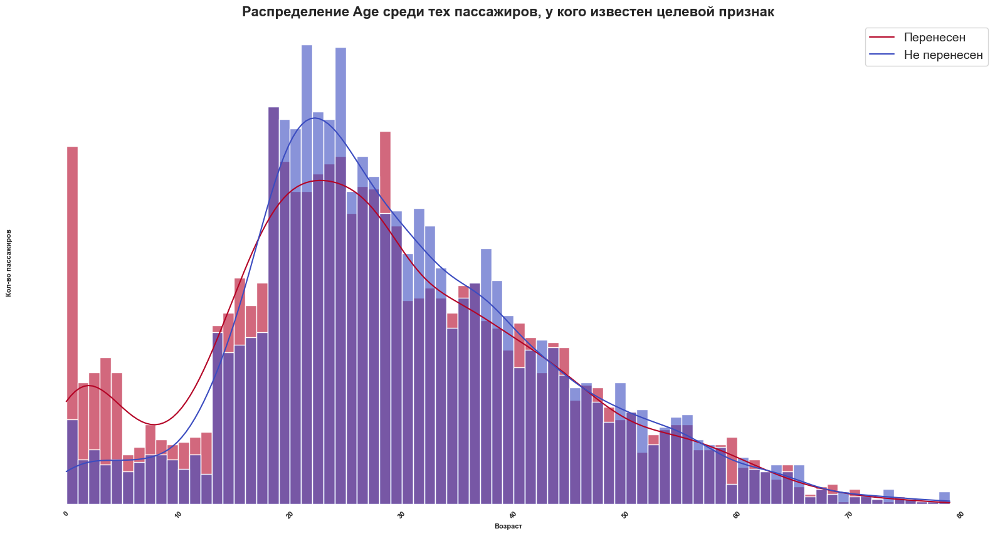

In [81]:
plot_hist_with_target(df, "Age")

Дети чаще переносились в альтернативное измерение, чем взрослые. Чем младше пассажир, тем больше вероятность, что он попадет в альтернативное измерение.

Создадим группы по возрасту (берем визуально оптимальные границы):

In [82]:
def group_age(df_: pd.DataFrame) -> pd.DataFrame:
    col_name = "Age"
    new_col_name = "AgeGroup"
    df_[new_col_name] = np.nan
    df_.loc[df_[col_name] < 5, new_col_name] = "0-4"
    df_.loc[(df_[col_name] >= 5) & (df_[col_name] <= 12), new_col_name] = "05-12"
    df_.loc[(df_[col_name] >= 13) & (df_[col_name] <= 17), new_col_name] = "13-17"
    df_.loc[(df_[col_name] >= 18) & (df_[col_name] <= 24), new_col_name] = "18-24"
    df_.loc[(df_[col_name] >= 25) & (df_[col_name] <= 29), new_col_name] = "25-29"
    df_.loc[(df_[col_name] >= 29) & (df_[col_name] <= 38), new_col_name] = "35-38"
    df_.loc[(df_[col_name] >= 39) & (df_[col_name] <= 44), new_col_name] = "39-44"
    df_.loc[(df_[col_name] >= 45) & (df_[col_name] <= 50), new_col_name] = "45-50"
    df_.loc[(df_[col_name] >= 51) & (df_[col_name] <= 55), new_col_name] = "51-55"
    df_.loc[(df_[col_name] >= 56) & (df_[col_name] <= 65), new_col_name] = "56-65"
    df_.loc[df_[col_name] > 65, new_col_name] = "65+"
    return df_


df = group_age(df)
df.AgeGroup.value_counts().sort_index()

AgeGroup
0-4       664
05-12     493
13-17    1107
18-24    3228
25-29    1573
35-38    2679
39-44    1127
45-50     756
51-55     435
56-65     511
65+       127
Name: count, dtype: int64

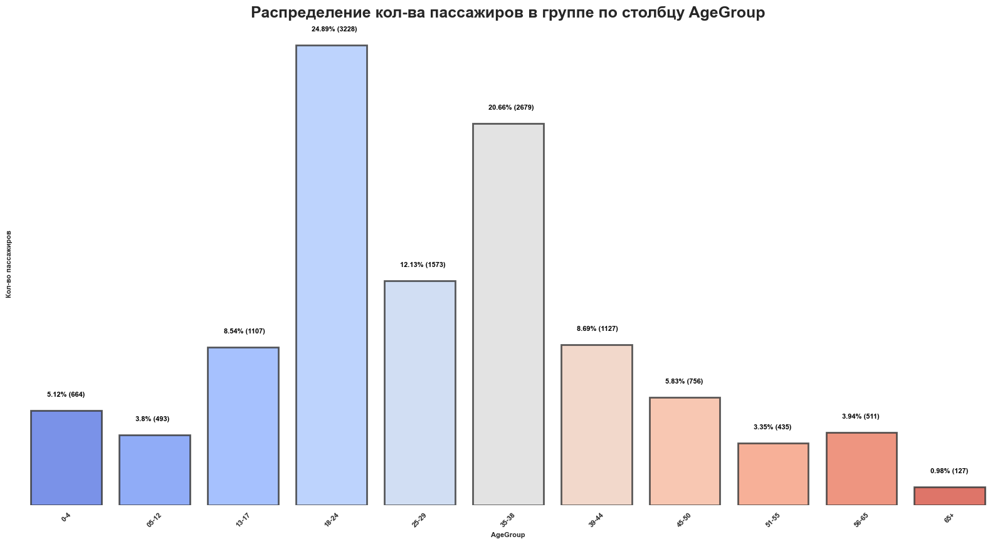

In [83]:
plot_dist(df, "AgeGroup", text_=True)

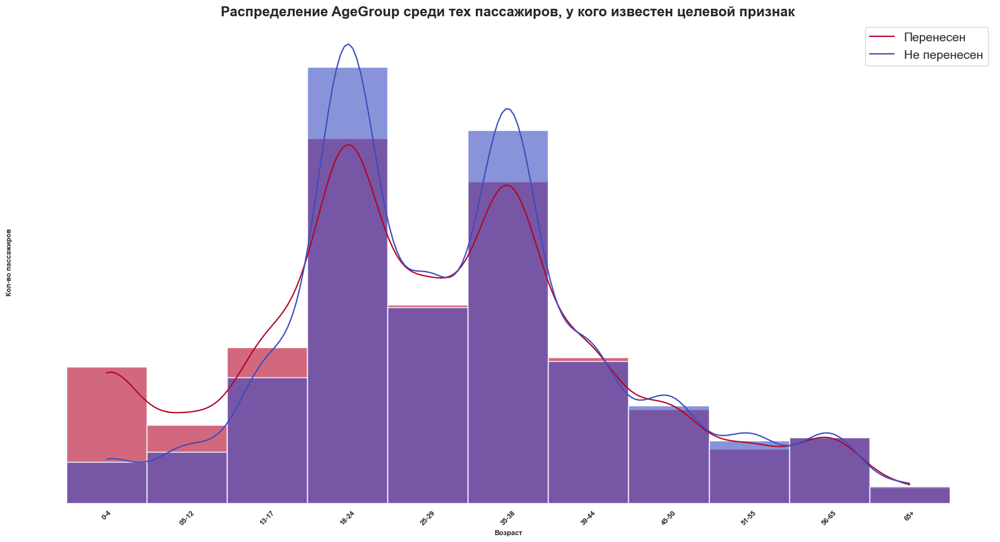

In [84]:
plot_hist_with_target(df, "AgeGroup")

Посмотрим на распределение возраста в зависимости от расположения каюты:

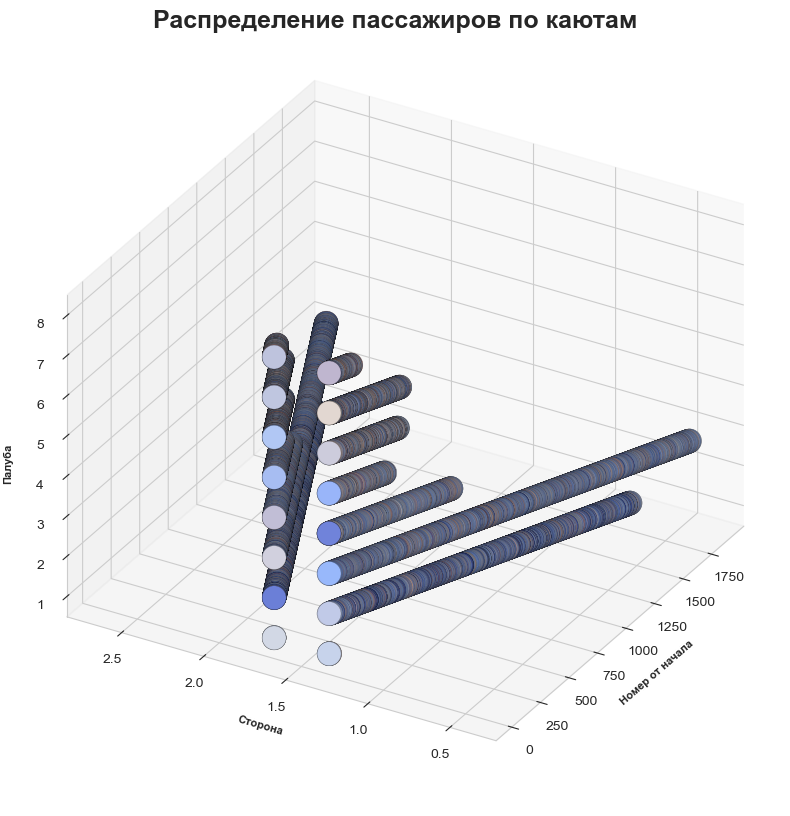

In [85]:
mask = df.CabinDeck.notnull() & df.CabinNum.notnull() & df.CabinSide.notnull() & df.Age.notnull()
plot_3d_titanik_with_col(df[mask], "Age")

Четкой зависимости не видно. Посмотрим на распределение возраста в зависимости от родной планеты:

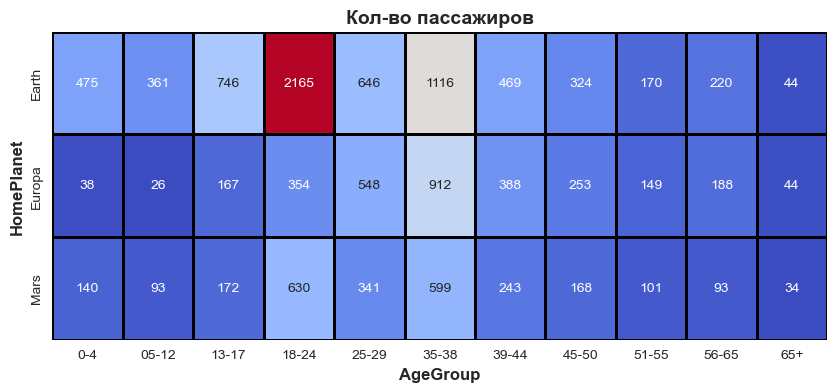

In [86]:
plot_heat_map_with_col(df, "HomePlanet", "AgeGroup")

Тоже самое для планеты, на которую направляются:

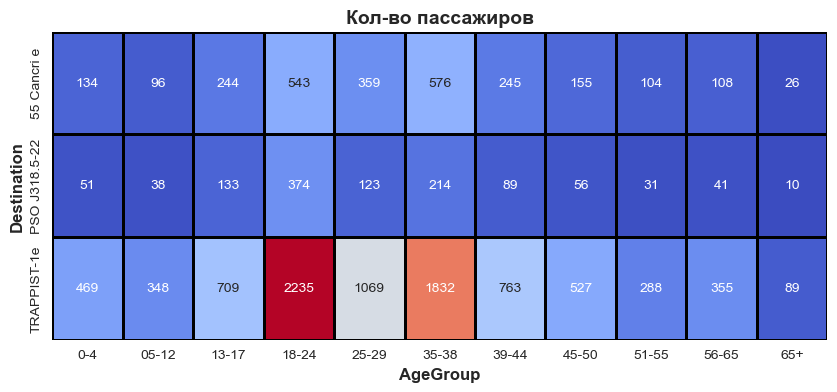

In [87]:
plot_heat_map_with_col(df, "Destination", "AgeGroup")

У каждой возрастной группы есть фавориты среди планет, на которые они направляются. Посмотрим на распределение возраста в зависимости от **VIP**-статуса:

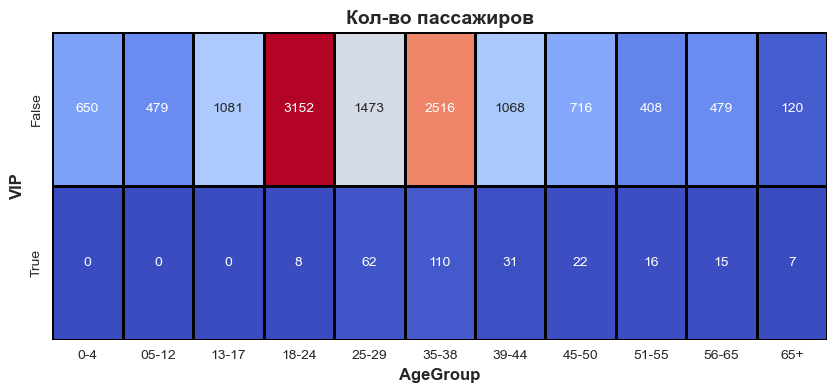

In [88]:
plot_heat_map_with_col(df, "VIP", "AgeGroup")

**VIP**-статус есть только у людей старше 18 лет. Посмотрим на распределение возраста в зависимости от того, находится ли пассажир в криосне:

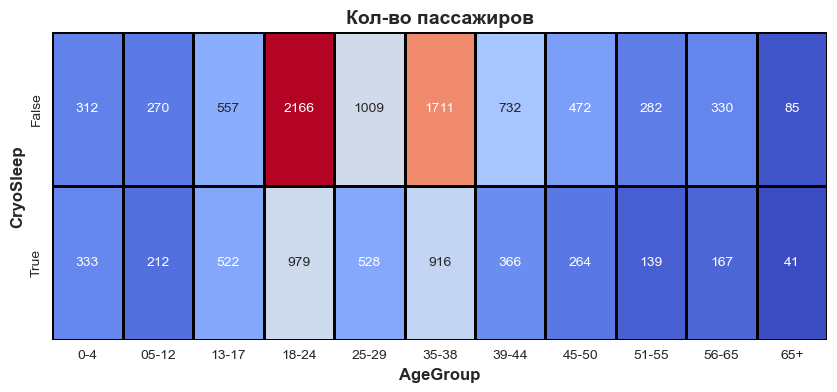

In [89]:
plot_heat_map_with_col(df, "CryoSleep", "AgeGroup")

Интересно то, что чем старше пассажир, тем больше вероятность, что он не будет находиться в криосне. Посмотрим на распределение возраста в зависимости от того, находится ли пассажир в группе:

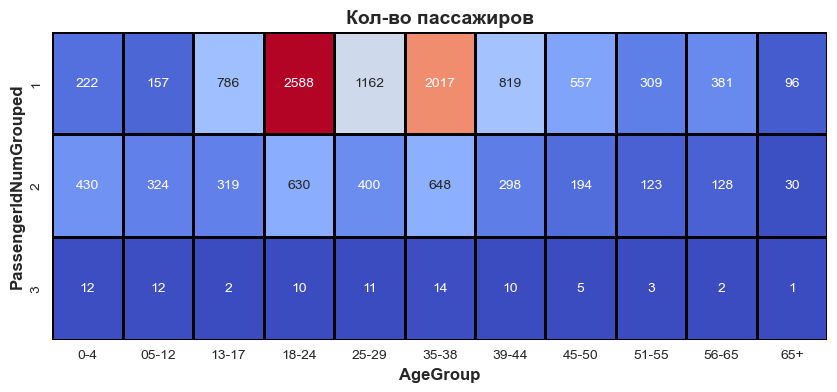

In [90]:
plot_heat_map_with_col(df, "PassengerIdNumGrouped", "AgeGroup")

Чем старше пассажир, тем больше вероятность, что он будет лететь в одиночку. Чем младше пассажир, тем больше вероятность, что он будет лететь в группе. При этом пожилые люди чаще летят парами (если смотреть на соотношение кол-ва пассажиров в группе).

Посмотрим на распределение возраста в зависимости от того, попал ли пассажир в альтернативное измерение:

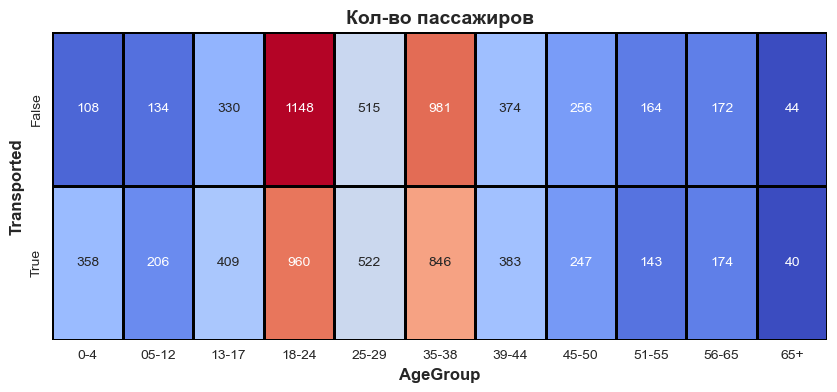

In [91]:
plot_heat_map_with_col(df, target_col, "AgeGroup")

Детей чаще переносило в альтернативное измерение, чем взрослых. Чем младше пассажир, тем больше вероятность, что он попадет в альтернативное измерение. Больше всего шансов не попасть в альтернативное измерение у пассажиров в возрасте от 18 до 24  и от 35 до 38 лет.

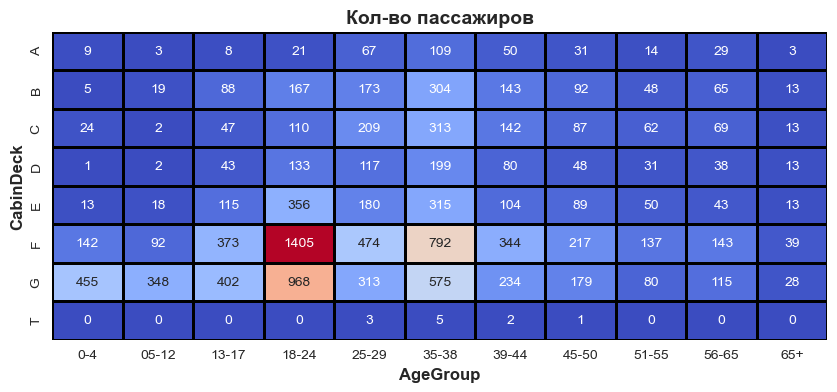

In [92]:
plot_heat_map_with_col(df, "CabinDeck", "AgeGroup")

Дети до 18 лет находятся чаще находятся на палубе **G**, как и пожилые люди.

#### ALL Expanses

---

Сумма всех расходов пассажира на время путешествия. _Включает в себя стоимость всех дополнительных услуг._

In [98]:
def sum_expanses(df_: pd.DataFrame) -> pd.DataFrame:
    df_["AllExpanses"] = df_["RoomService"].fillna(0) + df_["FoodCourt"].fillna(0) + df_["ShoppingMall"].fillna(0) + df_["Spa"].fillna(0) + df_["VRDeck"].fillna(0)
    df_["WithoutExpanses"] = df_["AllExpanses"].apply(lambda x: 1 if x == 0 else 0)
    return df_

def create_new_boolean_future(df_: pd.DataFrame) -> pd.DataFrame:
    
    def _create(col_: str) -> pd.DataFrame:
        return df_[col_].apply(lambda x: (1 if x > 0 else 0) if isinstance(x, (int, float)) else np.nan)
    
    cols_lst_ = ["RoomService", "FoodCourt", "ShoppingMall", "Spa", "VRDeck"]
    
    for col in cols_lst_:
        df_[col] = _create(col)
    df_.drop(cols_lst_, axis=1, inplace=True)
    return df_


df = sum_expanses(df)
# df = create_new_boolean_future(df)

df.iloc[:, -7:].describe()

,AllExpanses,WithoutExpanses
count,12970.000000,12970.000000
mean,1433.221049,0.420740
std,2807.369708,0.493697
min,0.000000,0.000000
25%,0.000000,0.000000
50%,716.000000,0.000000
75%,1442.000000,1.000000
max,35987.000000,1.000000


Посмотрим на распределение расходов:

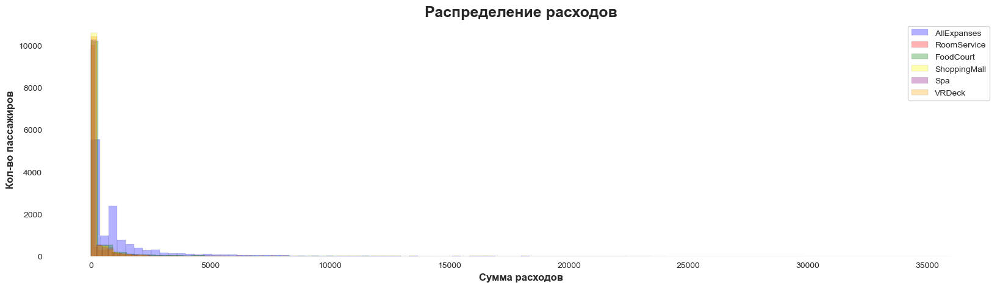

In [96]:
def plot_hist_expanses(df_: pd.DataFrame) -> None:

    plt.figure(figsize=(20, 5))

    params_ = dict(
        kind="hist",
        bins=100,
        alpha=0.3,
        linewidth=0.2,
        edgecolor="black"
    )

    df_["AllExpanses"].plot(color="blue", **params_)
    df_["RoomService"].plot(color="red", **params_)
    df_["FoodCourt"].plot(color="green", **params_)
    df_["ShoppingMall"].plot(color="yellow", **params_)
    df_["Spa"].plot(color="purple", **params_)
    df_["VRDeck"].plot(color="orange", **params_)

    plt.title("Распределение расходов", fontsize=18, fontweight="bold")
    plt.xlabel("Сумма расходов", fontsize=12, fontweight="bold")
    plt.ylabel("Кол-во пассажиров", fontsize=12, fontweight="bold")

    sns.despine(left=True, bottom=True)
    plt.grid(False)
    plt.legend()

    plt.show()

plot_hist_expanses(df)

Посмотрим на наличие расходов у пассажиров в зависимости от родной планеты:

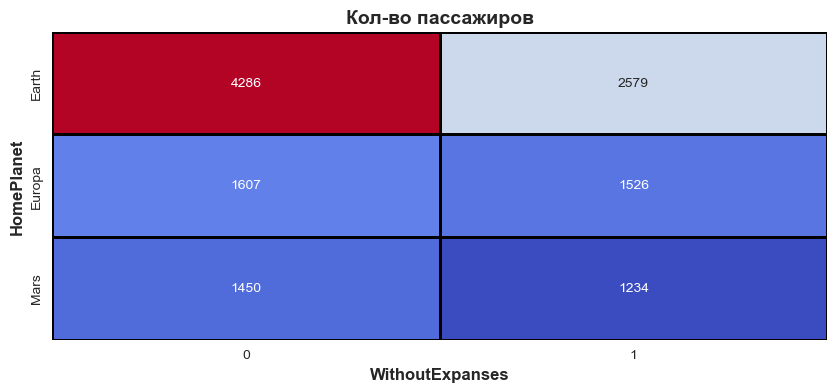

In [99]:
plot_heat_map_with_col(df, "HomePlanet", "WithoutExpanses")

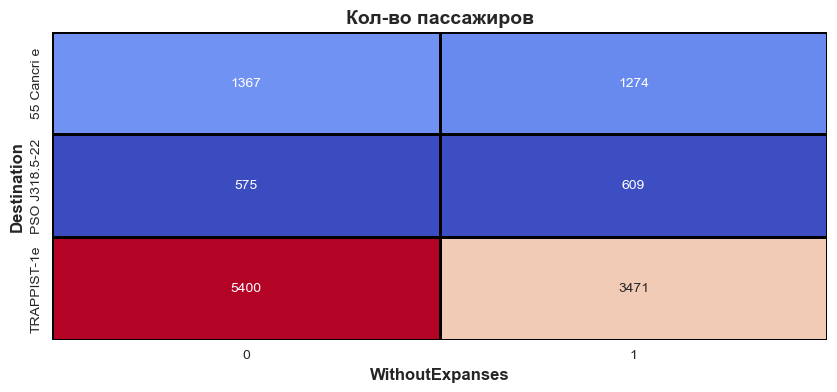

In [100]:
plot_heat_map_with_col(df, "Destination", "WithoutExpanses")

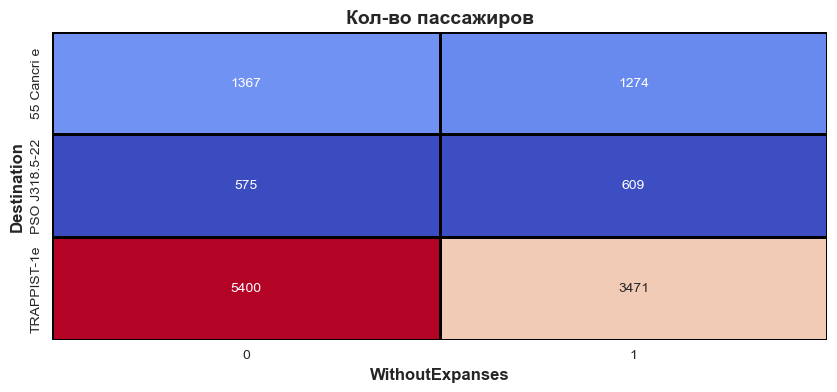

In [318]:
plot_heat_map_with_col(df, "Destination", "WithoutExpanses")

Как можем увидеть, охотнее тратятся те, кто летит с Европы, и те, кто летит на экзопланету **PSO J318.5-22**.

Посмотрим на распределение расходов в зависимости от **VIP**-статуса:

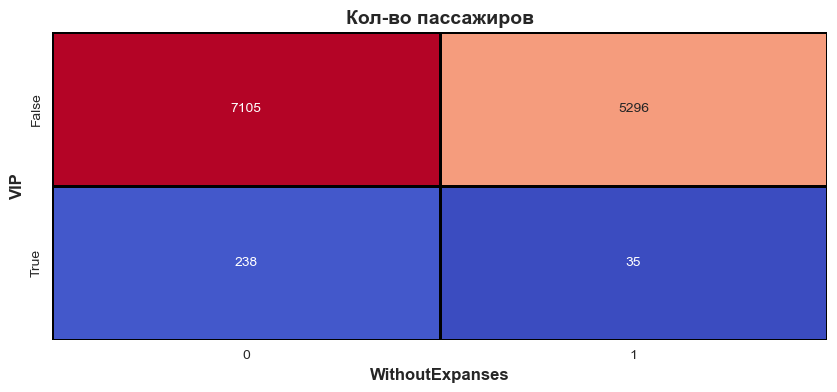

In [319]:
plot_heat_map_with_col(df, "VIP", "WithoutExpanses")

VIP-пассажиры охотнее тратятся на дополнительные услуги (практически в 8 раз чаще).

Посмотрим на распределение расходов в зависимости от того, находится ли пассажир в криосне:

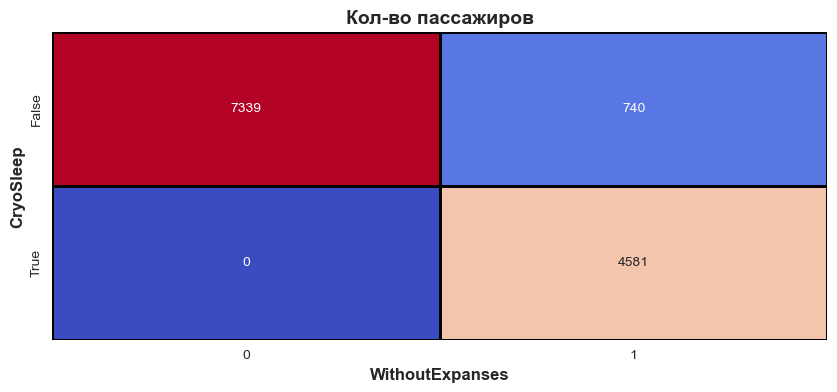

In [320]:
plot_heat_map_with_col(df, "CryoSleep", "WithoutExpanses")

За редким исключением, пассажиры в криосне тратятся на дополнительные услуги.

Посмотрим на распределение расходов в зависимости от того, находится ли пассажир в группе:

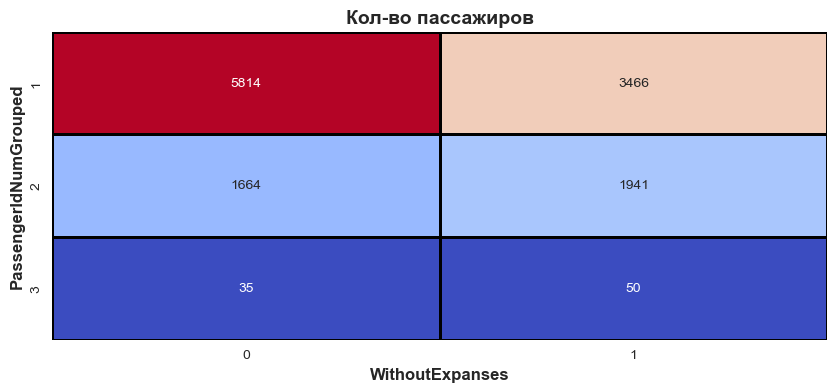

In [321]:
plot_heat_map_with_col(df, "PassengerIdNumGrouped", "WithoutExpanses")

Видим хорошую зависимость. Одинокие люди охотнее тратятся на дополнительные услуги.

Посмотрим на распределение расходов в зависимости от того, попал ли пассажир в альтернативное измерение:

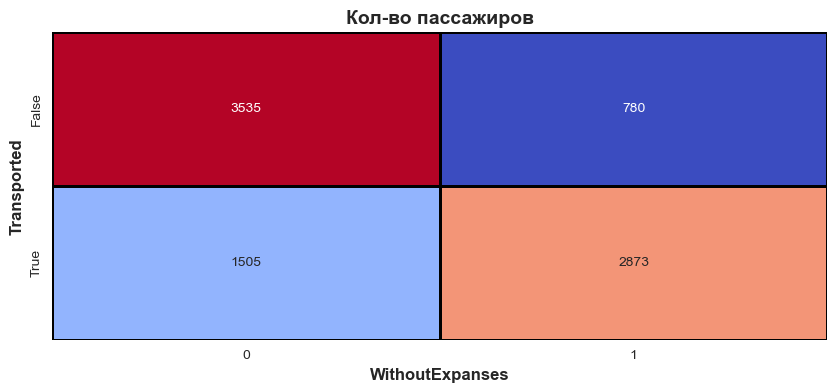

In [322]:
plot_heat_map_with_col(df, target_col, "WithoutExpanses")

Здесь так же наблюдается зависимость. Пассажиры, которые не попали в альтернативное измерение, охотнее тратились на дополнительные услуги. Вероятнее всего, здесь есть взаимосвязь с криосном. Пассажиры, которыене были в криосне, и могли пользоваться дополнительными услугами, реже попадали в альтернативное измерение.

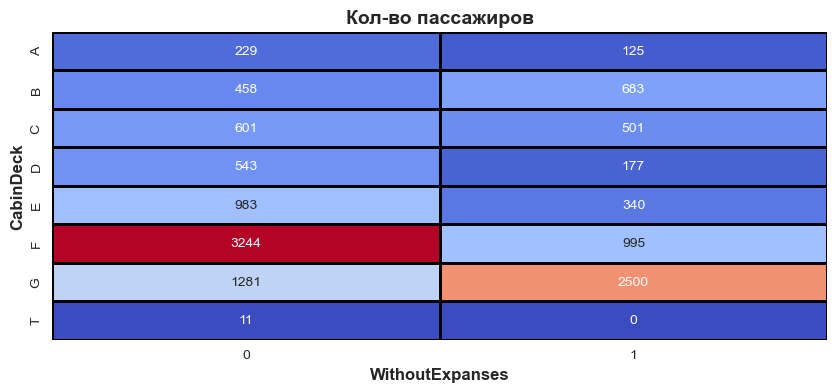

In [323]:
plot_heat_map_with_col(df, "CabinDeck", "WithoutExpanses")

Именно на палубах **F** и **D** пассажиры охотнее тратились на дополнительные услуги. На палубе **T** все немногочисленные пассажиры тратились на дополнительные услуги.

### Восстановление данных

---

Попробуем восстановить данные, которые не были заполнены.

In [101]:
def print_null_spec_values(df_: pd.DataFrame, col_: str) -> None:
    values = df_[col_].count()
    row = df_.shape[0]
    missing_values = df_[col_].isnull().sum()
    perc = (values / row) * 100
    print(f"{col_:^12} -> всего: {values:^5}, пропущенных значений: {missing_values:^3}, {100 - perc:.2f}%")

#### HomePlanet

---

Как мы выяснили ранее:
* Пассажиры на палубах **A**, **B**, **C** или **T** прибыли с планеты Европа
* Пассажиры на палубе **G** прибыли с Земли
* Пассажиры на палубах **D** с Европы или Марса
* Пассажиры на палубах **F** с Земли или Марса
* Пассажиры на палубах **E** со всех планет

Попробуем восстановить данные, используя эту информацию:

In [102]:
def restore_home_planet_1(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df, "HomePlanet")
    df.loc[df.HomePlanet.isna(), "HomePlanet"] = df.loc[df.HomePlanet.isna(), :].apply(
        lambda x: "Earth" if x.CabinDeck in ["G"] else ("Europa" if x.CabinDeck in ["A", "B", "C", "T"] else np.nan),
        axis=1
    )
    print_null_spec_values(df, "HomePlanet")
    return df_


df = restore_home_planet_1(df)

 HomePlanet  -> всего: 12682, пропущенных значений: 288, 2.22%
 HomePlanet  -> всего: 12810, пропущенных значений: 160, 1.23%


Пассажиры в одной каюте прибыли с одной планеты. Попробуем использовать это:

In [103]:
def restore_home_planet_2(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "HomePlanet")
    df_.loc[df_.HomePlanet.isna(), "HomePlanet"] = df_.loc[df_.HomePlanet.isna() & df_.CabinDeck.notna() & df_.CabinNum.notna() & df_.CabinSide.notna(), :].apply(
        lambda x: df_[(df_.CabinDeck == x.CabinDeck) & (df_.CabinNum == x.CabinNum) & (df_.CabinSide == x.CabinSide)].HomePlanet.mode()[0] 
        if len(df_[(df_.CabinDeck == x.CabinDeck) & (df_.CabinNum == x.CabinNum) & (df_.CabinSide == x.CabinSide)].HomePlanet.mode()) > 0 else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "HomePlanet")
    return df_


df = restore_home_planet_2(df)

 HomePlanet  -> всего: 12810, пропущенных значений: 160, 1.23%
 HomePlanet  -> всего: 12852, пропущенных значений: 118, 0.91%


Попробуем восстановить данные, используя информацию о группе, в которой находился пассажир:

In [104]:
def restore_home_planet_3(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "HomePlanet")
    df_.loc[df_.HomePlanet.isna(), "HomePlanet"] = df_.loc[df_.HomePlanet.isna() & df_.PassengerIdGroup.notna(), :].apply(
        lambda x: df_[df_.PassengerIdGroup == x.PassengerIdGroup].HomePlanet.mode()[0] 
        if len(df_[df_.PassengerIdGroup == x.PassengerIdGroup].HomePlanet.mode()) > 0 else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "HomePlanet")
    return df_


df = restore_home_planet_3(df)

 HomePlanet  -> всего: 12852, пропущенных значений: 118, 0.91%
 HomePlanet  -> всего: 12876, пропущенных значений: 94 , 0.72%


Попробуем восстановить данные, используя информацию о планете в комбинации с информацией о фамилии, стороне корабля и палубе:

In [105]:
def restore_home_planet_4(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "HomePlanet")
    df_.loc[df_.HomePlanet.isna(), "HomePlanet"] = df_.loc[df_.HomePlanet.isna() & df_.LastName.notna() & df_.CabinSide.notna() & df_.CabinDeck.notna(), :].apply(
        lambda x: df_[(df_.LastName == x.LastName) & (df_.CabinSide == x.CabinSide) & (df_.CabinDeck == x.CabinDeck)].HomePlanet.mode()[0] 
        if len(df_[(df_.LastName == x.LastName) & (df_.CabinSide == x.CabinSide) & (df_.CabinDeck == x.CabinDeck)].HomePlanet.mode()) > 0 else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "HomePlanet")
    return df_


df = restore_home_planet_4(df)

 HomePlanet  -> всего: 12876, пропущенных значений: 94 , 0.72%
 HomePlanet  -> всего: 12926, пропущенных значений: 44 , 0.34%


#### Destination

---

Попробуем восстановить данные, используя эту информацию о группе, в которой находился пассажир:

In [106]:
def restore_destination_1(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "Destination")
    df_.loc[df_.Destination.isna(), "Destination"] = df_.loc[df_.Destination.isna() & df_.PassengerIdGroup.notna(), :].apply(
        lambda x: df_[df_.PassengerIdGroup == x.PassengerIdGroup].Destination.mode()[0] if len(df_[df_.PassengerIdGroup == x.PassengerIdGroup].Destination.mode()) > 0 else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "Destination")
    return df_


df = restore_destination_1(df)

Destination  -> всего: 12696, пропущенных значений: 274, 2.11%
Destination  -> всего: 12816, пропущенных значений: 154, 1.19%


Попробуем восстановить данные, используя информацию о планете в комбинации с информацией о фамилии, стороне корабля и палубе:

In [107]:
def restore_destination_2(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "Destination")
    df_.loc[df_.Destination.isna(), "Destination"] = df_.loc[df_.Destination.isna() & df_.LastName.notna() & df_.CabinSide.notna() & df_.CabinDeck.notna(), :].apply(
        lambda x: df_[(df_.LastName == x.LastName) & (df_.CabinSide == x.CabinSide) & (df_.CabinDeck == x.CabinDeck)].Destination.mode()[0] 
        if len(df_[(df_.LastName == x.LastName) & (df_.CabinSide == x.CabinSide) & (df_.CabinDeck == x.CabinDeck)].Destination.mode()) > 0 else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "Destination")
    return df_


df = restore_destination_2(df)

Destination  -> всего: 12816, пропущенных значений: 154, 1.19%
Destination  -> всего: 12911, пропущенных значений: 59 , 0.45%


Воспользуемся информацией о планете в комбинации с информацией о криосне, наличии расходов на дополнительные услуги и **VIP**-статусе:

In [108]:
def restore_destination_3(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "Destination")
    df_.loc[df_.Destination.isna(), "Destination"] = df_.loc[df_.Destination.isna() & df_.CryoSleep.notna() & df_.WithoutExpanses.notna() & df_.VIP.notna(), :].apply(
        lambda x: df_[(df_.CryoSleep == x.CryoSleep) & (df_.WithoutExpanses == x.WithoutExpanses) & (df_.VIP == x.VIP)].Destination.mode()[0] 
        if len(df_[(df_.CryoSleep == x.CryoSleep) & (df_.WithoutExpanses == x.WithoutExpanses) & (df_.VIP == x.VIP)].Destination.mode()) > 0 else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "Destination")
    return df_


df = restore_destination_3(df)

Destination  -> всего: 12911, пропущенных значений: 59 , 0.45%
Destination  -> всего: 12965, пропущенных значений:  5 , 0.04%


Попробуем восстановить данные, используя информацию о палубе, на которой находился пассажир:

Например, вероятнее всего, что на **Trapppist-1e** летели пассажиры, находящиеся на палубе **E**:

In [109]:
def restore_destination_4(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "Destination")
    df_.loc[df_.Destination.isna(), "Destination"] = df_.loc[df.Destination.isna() & df_.CabinDeck.notna(), :].CabinDeck.apply(
        lambda x: "TRAPPIST-1e" if x == "E" else np.nan,
    )
    print_null_spec_values(df_, "Destination")
    return df_


df = restore_destination_4(df)

Destination  -> всего: 12965, пропущенных значений:  5 , 0.04%
Destination  -> всего: 12967, пропущенных значений:  3 , 0.02%


#### VIP

---

VIP статуса нет у детей. Попробуем восстановить данные, используя эту информацию:

In [110]:
def restore_vip_1(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "VIP")
    df_.loc[df_.VIP.isna(), "VIP"] = df_.loc[df_.VIP.isna(), :].apply(
        lambda x: False if x.Age < 18 else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "VIP")
    return df_


df = restore_vip_1(df)

    VIP      -> всего: 12674, пропущенных значений: 296, 2.28%
    VIP      -> всего: 12728, пропущенных значений: 242, 1.87%


Пассажиры, летевшие с **Марса** на **55 Cancri e** не приобретали **VIP**-статус:

In [111]:
def restore_vip_2(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "VIP")
    df_.loc[df_.VIP.isna(), "VIP"] = df_.loc[df_.VIP.isna() & df_.HomePlanet.notna() & df_.Destination.notna(), :].apply(
        lambda x: False if (x.HomePlanet == "Mars") & (x.Destination == "55 Cancri e") else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "VIP")
    return df_


df = restore_vip_2(df)

    VIP      -> всего: 12728, пропущенных значений: 242, 1.87%
    VIP      -> всего: 12731, пропущенных значений: 239, 1.84%


Пассажиры, летевшие с **Земли** не приобретали **VIP**-статус:

In [112]:
def restore_vip_3(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "VIP")
    df_.loc[df_.VIP.isna(), "VIP"] = df_.loc[df_.VIP.isna() & df_.HomePlanet.notna(), :].apply(
        lambda x: False if x.HomePlanet == "Earth" else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "VIP")
    return df_


df = restore_vip_3(df)

    VIP      -> всего: 12731, пропущенных значений: 239, 1.84%
    VIP      -> всего: 12849, пропущенных значений: 121, 0.93%


Скорее всего, если пассажир прибывал в криосне или не тратился на дополнительные услуги, то в комбинации с информацией о планетах с которой и на которую он летел, мы можем восстановить данные:

In [113]:
def restore_vip_4(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "VIP")
    df_.loc[df_.VIP.isna(), "VIP"] = df_.loc[df_.VIP.isna() & df_.CryoSleep.notna() & df_.WithoutExpanses.notna() & df_.HomePlanet.notna() & df_.Destination.notna(), :].apply(
        lambda x: False if (x.CryoSleep == True) | (x.WithoutExpanses == True) | ((x.HomePlanet == "Earth") & (x.Destination == "55 Cancri e")) else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "VIP")
    return df_


df = restore_vip_4(df)

    VIP      -> всего: 12849, пропущенных значений: 121, 0.93%
    VIP      -> всего: 12903, пропущенных значений: 67 , 0.52%


#### CryoSleep

---

Мы точно знаем, что большинство VIP-пассажиров или имеют расходы на дополнительные услуги, или не находятся в криосне:

In [114]:
def restore_cryosleep_1(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "CryoSleep")
    df_.loc[df_.CryoSleep.isna(), "CryoSleep"] = df_.loc[df_.CryoSleep.isna() & df_.VIP.notna() & df_.WithoutExpanses.notna(), :].apply(
        lambda x: False if (x.VIP == True) | (x.WithoutExpanses == True) else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "CryoSleep")
    return df_


df = restore_cryosleep_1(df)

 CryoSleep   -> всего: 12660, пропущенных значений: 310, 2.39%
 CryoSleep   -> всего: 12800, пропущенных значений: 170, 1.31%


Так же в криосне не находились те, у кого есть расходы на дополнительные услуги:

In [115]:
def restore_cryosleep_2(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "CryoSleep")
    df_.loc[df_.CryoSleep.isna(), "CryoSleep"] = df_.loc[df_.CryoSleep.isna() & df_.WithoutExpanses.notna(), :].apply(
        lambda x: False if x.WithoutExpanses == False else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "CryoSleep")
    return df_


df = restore_cryosleep_2(df)

 CryoSleep   -> всего: 12800, пропущенных значений: 170, 1.31%
 CryoSleep   -> всего: 12968, пропущенных значений:  2 , 0.02%


In [116]:
df_checkpoint = df.copy()

#### CabinNum

---

Так как у нас есть зависимость линейная зависимость между номером каюты, номером группы и палубой, то можем восстановить данные, используя линейную регрессию. Предсказывать будем те номера каюты, которые были пропущены в последовательности:

In [122]:
dct_missing_cabin_num = dict()
for side in list(df.CabinSide.sort_values().unique()):
    for deck in list(df.CabinDeck.sort_values().unique()):
        mask = df.CabinNum.notnull() & (df.CabinSide == side) & (df.CabinDeck == deck)
        df_extra = df[mask].copy()
        if df_extra.shape[0] > 0:
            df_extra["CabinNum"] = df_extra["CabinNum"].astype(int)
            max_num = int(df_extra.CabinNum.max())
            min_num = int(df_extra[df_extra.CabinNum != 0].CabinNum.min())
            miss_lst = [i for i in range(min_num, max_num + 1) if i not in df_extra.CabinNum.unique()]
            dct_missing_cabin_num[f"{side}_{deck}"] = {
                "side": side,
                "deck": deck,
                "min_num": min_num,
                "max_num": max_num,
                "miss_lst": miss_lst
            }
            print(f"Сторона: {side}, палуба: {deck}, минимальный номер: {min_num}, максимальный номер: {max_num}, кол-во пропущенных номеров: {len(miss_lst)}")

Сторона: P, палуба: A, минимальный номер: 1, максимальный номер: 98, кол-во пропущенных номеров: 1
Сторона: P, палуба: B, минимальный номер: 1, максимальный номер: 301, кол-во пропущенных номеров: 5
Сторона: P, палуба: C, минимальный номер: 1, максимальный номер: 309, кол-во пропущенных номеров: 2
Сторона: P, палуба: D, минимальный номер: 1, максимальный номер: 297, кол-во пропущенных номеров: 9
Сторона: P, палуба: E, минимальный номер: 1, максимальный номер: 598, кол-во пропущенных номеров: 18
Сторона: P, палуба: F, минимальный номер: 1, максимальный номер: 1894, кол-во пропущенных номеров: 31
Сторона: P, палуба: G, минимальный номер: 1, максимальный номер: 1508, кол-во пропущенных номеров: 26
Сторона: P, палуба: T, минимальный номер: 1, максимальный номер: 4, кол-во пропущенных номеров: 0
Сторона: S, палуба: A, минимальный номер: 1, максимальный номер: 109, кол-во пропущенных номеров: 0
Сторона: S, палуба: B, минимальный номер: 1, максимальный номер: 353, кол-во пропущенных номеров: 

In [134]:
def restore_cabin_num(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "CabinNum")
    mask = df_.CabinNum.isna() & df_.PassengerIdGroup.notna()
    df_.loc[mask, "CabinNum"] = df_.loc[mask, :].apply(
        lambda x: df_[(df_.PassengerIdGroup == x.PassengerIdGroup) & df_.CabinNum.notna()].CabinNum.values[0]
        if df_[(df_.PassengerIdGroup == x.PassengerIdGroup) & df_.CabinNum.notna()].shape[0] > 0 else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "CabinNum")
    return df_


df = restore_cabin_num(df)

  CabinNum   -> всего: 12808, пропущенных значений: 162, 1.25%
  CabinNum   -> всего: 12808, пропущенных значений: 162, 1.25%


#### CabinDeck

---

Основной фактор, по которому можем восстановить данные - это номер группы пассажиров.

In [135]:
def restore_cabin_deck(df_: pd.DataFrame) -> pd.DataFrame:
    print_null_spec_values(df_, "CabinDeck")
    mask = df_.CabinDeck.isna() & df_.PassengerIdGroup.notna()
    df_.loc[mask, "CabinDeck"] = df_.loc[mask, :].apply(
        lambda x: df_[(df_.PassengerIdGroup == x.PassengerIdGroup) & df_.CabinDeck.notna()].CabinDeck.values[0]
        if df_[(df_.PassengerIdGroup == x.PassengerIdGroup) & df_.CabinDeck.notna()].shape[0] > 0 else np.nan,
        axis=1
    )
    print_null_spec_values(df_, "CabinDeck")
    return df_


df = restore_cabin_deck(df)

 CabinDeck   -> всего: 12671, пропущенных значений: 299, 2.31%
 CabinDeck   -> всего: 12808, пропущенных значений: 162, 1.25%


#### Other

---

Избавимся от **FirstName**, **RoomService**, **FoodCourt**, **ShoppingMall**, **Spa**, **VRDeck**.

Остальные значения, мы попробуем восстановить при помощи `KNNImputer` :

In [136]:
df_checkpoint = df.copy()

In [950]:
# df.drop(columns=["FirstName", "RoomService", "FoodCourt", "ShoppingMall", "Spa", "VRDeck"], inplace=True)
df.drop(columns=["FirstName", "AgeGroup"], inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12970 entries, 0 to 12969
Data columns (total 15 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   HomePlanet             12966 non-null  object 
 1   CryoSleep              12834 non-null  object 
 2   Destination            12860 non-null  object 
 3   Age                    12700 non-null  float64
 4   VIP                    12904 non-null  object 
 5   Transported            8693 non-null   object 
 6   PassengerIdGroup       12970 non-null  int64  
 7   PassengerIdNum         12970 non-null  int64  
 8   PassengerIdNumGrouped  12970 non-null  int64  
 9   CabinDeck              12808 non-null  object 
 10  CabinNum               12970 non-null  object 
 11  CabinSide              12671 non-null  object 
 12  LastName               12970 non-null  object 
 13  AllExpanses            12970 non-null  float64
 14  WithoutExpanses        12970 non-null  int64  
dtypes:

**Преобразуем категориальные признаки в числовые:**

In [137]:
def process_other(df_: pd.DataFrame) -> pd.DataFrame:
    def convert_col_to_int(col_: str) -> None:
        df_.loc[df_[col_].notna()][col_] = df_[df_[col_].notna()][col_].astype(int)


    df_ = pd.get_dummies(df_, columns=[
        "HomePlanet",
        "Destination",
        "CabinSide",
        # "FirstName",
        # "LastName"
    ])
    df_["LastName"] = df_["LastName"].astype("category").cat.codes
    df_["FirstName"] = df_["FirstName"].astype("category").cat.codes
    # df.drop(columns=["LastName"], inplace=True)
    
    age_group_dct = {
        "0-4": 1,
        "05-12": 2,
        "13-17": 3,
        "18-24": 4,
        "25-29": 5,
        "35-38": 6,
        "39-44": 7,
        "45-50": 8,
        "51-55": 9,
        "56-65": 10,
        "65+": 11
    }
    df_["AgeGroup"] = df_["AgeGroup"].map(age_group_dct)
    
    cabin_deck_dct = {
        "A": 1,
        "B": 2,
        "C": 3,
        "D": 4,
        "E": 5,
        "F": 6,
        "G": 7,
        "T": 8
    }
    df_["CabinDeck"] = df_["CabinDeck"].map(cabin_deck_dct)
    
    convert_col_to_int("VIP")
    convert_col_to_int("CryoSleep")
    convert_col_to_int("WithoutExpanses")
    # convert_col_to_int("RoomServiceExpanses")
    # convert_col_to_int("FoodCourtExpanses")
    # convert_col_to_int("ShoppingMallExpanses")
    # convert_col_to_int("SpaExpanses")
    # convert_col_to_int("VRDeckExpanses")
    
    return df_


df = process_other(df)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12970 entries, 0 to 12969
Data columns (total 27 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   CryoSleep                  12968 non-null  object 
 1   Age                        12700 non-null  float64
 2   VIP                        12903 non-null  object 
 3   RoomService                12707 non-null  float64
 4   FoodCourt                  12681 non-null  float64
 5   ShoppingMall               12664 non-null  float64
 6   Spa                        12686 non-null  float64
 7   VRDeck                     12702 non-null  float64
 8   Transported                8693 non-null   object 
 9   PassengerIdGroup           12970 non-null  int64  
 10  PassengerIdNum             12970 non-null  int64  
 11  PassengerIdNumGrouped      12970 non-null  int64  
 12  CabinDeck                  12808 non-null  float64
 13  CabinNum                   12808 non-null  obj

In [ ]:
# Extra
# print(df.shape)
# mask = df[target_col].notna()
# df.loc[mask, :] = df.loc[mask, :].dropna(subset=[col for col in df[mask].columns[df[mask].isna().any()].tolist() if col != target_col])
# df.reset_index(drop=True, inplace=True)
# print(df.shape)

Столбцы, которые нужно восстановить:

In [138]:
df_copy = df.drop(columns=[target_col]).copy()
columns_with_missing = df_copy.columns[df_copy.isna().any()].tolist()
print(len(columns_with_missing))

11


Восстановим данные при помощи `KNNImputer`:

In [139]:
df_to_impute = df_copy.loc[df_copy.notna().all(axis=1), :]
print(df_to_impute.shape)
df_to_submit = df_copy.loc[df_copy.isna().any(axis=1), :]
print(df_to_submit.shape)


imp = KNNImputer(n_neighbors=10, weights="uniform")
imp.fit(df_to_impute)
df_to_submit = pd.DataFrame(imp.transform(df_to_submit), columns=df_to_submit.columns, index=df_to_submit.index)

columns_with_missing = df_to_submit.columns[df_to_submit.isna().any()].tolist()
print(len(columns_with_missing))

(11155, 26)
(1815, 26)
0


In [140]:
df_copy.loc[df_to_submit.index, df_to_submit.columns] = df_to_submit
del df_to_submit, df_to_impute
df_copy = df_copy.astype(int, errors="ignore")
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12970 entries, 0 to 12969
Data columns (total 26 columns):
 #   Column                     Non-Null Count  Dtype
---  ------                     --------------  -----
 0   CryoSleep                  12970 non-null  int64
 1   Age                        12970 non-null  int64
 2   VIP                        12970 non-null  int64
 3   RoomService                12970 non-null  int64
 4   FoodCourt                  12970 non-null  int64
 5   ShoppingMall               12970 non-null  int64
 6   Spa                        12970 non-null  int64
 7   VRDeck                     12970 non-null  int64
 8   PassengerIdGroup           12970 non-null  int64
 9   PassengerIdNum             12970 non-null  int64
 10  PassengerIdNumGrouped      12970 non-null  int64
 11  CabinDeck                  12970 non-null  int64
 12  CabinNum                   12970 non-null  int64
 13  FirstName                  12970 non-null  int64
 14  LastName              

Оставшиеся данные заполним медианными значениями:

In [ ]:
imp_cols = df_copy.columns[df_copy.isna().any()].tolist()

imp = SimpleImputer(strategy="median")
imp.fit(df_copy[imp_cols])

df_copy[imp_cols] = imp.transform(df_copy[imp_cols])
df_copy[imp_cols] = imp.transform(df_copy[imp_cols])

df_copy = df_copy.astype(int, errors="ignore")
df_copy.info()

Мы восстановили все данные. Насколько удачно - увидим в дальнейшем.

# Моделирование

---

Посмотрим на корреляция основных признаков:

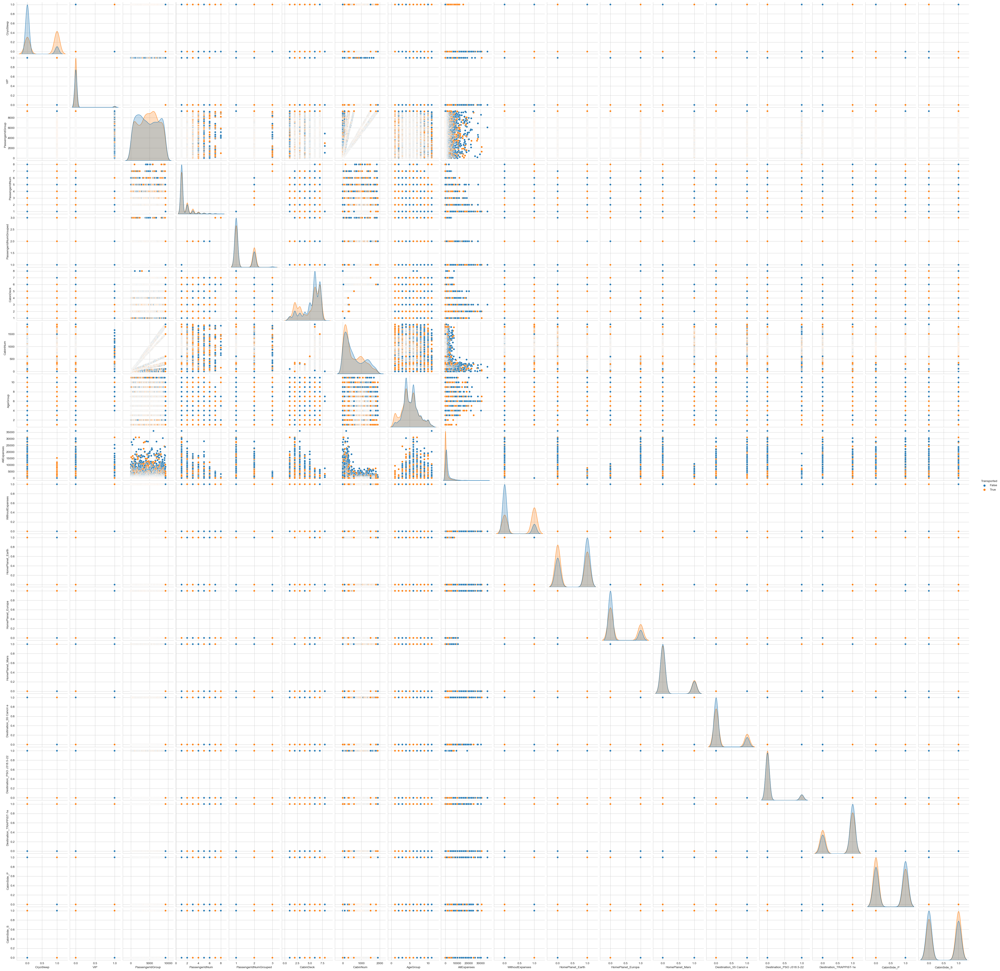

In [110]:
def plot_pairplot(df_x_: pd.DataFrame, df_y_: pd.Series) -> None:
    df_ = df_x_.copy()
    df_[target_col] = df_y_
    plt.rc("xtick", labelsize=10)
    plt.rc("ytick", labelsize=10)
    sns.pairplot(df_, hue=target_col)
    plt.show()

plot_pairplot(df_copy[df[target_col].notna()], df[target_col])

In [956]:
df_copy.describe()

,CryoSleep,Age,VIP,PassengerIdGroup,PassengerIdNum,PassengerIdNumGrouped,CabinDeck,CabinNum,LastName,AllExpanses,WithoutExpanses,HomePlanet_Earth,HomePlanet_Europa,HomePlanet_Mars,Destination_55 Cancri e,Destination_PSO J318.5-22,Destination_TRAPPIST-1e,CabinSide_P,CabinSide_S
count,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000,12970.000000
mean,0.356052,28.752814,0.021049,4635.337471,1.511488,1.291056,5.291596,594.857594,1459.651735,1433.221049,0.420740,0.540401,0.246646,0.212645,0.203624,0.102776,0.685120,0.484965,0.491981
std,0.478849,14.266094,0.143552,2685.904299,1.042500,0.468473,1.769577,514.064483,824.214600,2807.369708,0.493697,0.498384,0.431076,0.409194,0.402708,0.303677,0.464486,0.499793,0.499955
min,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,19.000000,0.000000,2306.250000,1.000000,1.000000,4.000000,162.000000,770.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,27.000000,0.000000,4632.000000,1.000000,1.000000,6.000000,417.000000,1458.000000,716.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000
75%,1.000000,37.000000,0.000000,6924.750000,2.000000,2.000000,7.000000,998.000000,2177.000000,1442.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
max,1.000000,79.000000,1.000000,9280.000000,8.000000,3.000000,8.000000,1894.000000,2883.000000,35987.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [141]:
def split_train_valid_test(df_: pd.DataFrame, test_: bool = True, valid_: bool = False) -> tuple:

    def _split_x_y() -> tuple:
        return df_.drop(target_col, axis=1), df_[target_col]

    def _split(x_df_: pd.DataFrame, y_array_: np.array, test_size_: float) -> tuple:
        return train_test_split(
            x_df_,
            y_array_,
            test_size=test_size_,
            random_state=666,
            stratify=y_array_,
            shuffle=True
        )

    def _print_result_info() -> None:
        print(f"X Train: {X_train_.shape}")
        print(f"y Train: {y_train_.shape}", end="\n\n")

        if valid_:
            print(f"X Valid: {X_val_.shape}")
            print(f"y Valid: {y_val_.shape}", end="\n\n")
        
        if test_:
            print(f"X Test:  {X_test_.shape}")
            print(f"y Test:  {y_test_.shape}", end="\n\n")

    X_, y_ = _split_x_y()
    if valid_:
        X_train_, X_temp_, y_train_, y_temp_ = _split(X_, y_, test_size_=0.4)
        X_val_, X_test_, y_val_, y_test_ = _split(X_temp_, y_temp_, test_size_=0.5)
        _print_result_info()
        return X_train_, X_val_, X_test_, y_train_, y_val_, y_test_
    elif test_:
        X_train_, X_test_, y_train_, y_test_ = _split(X_, y_, test_size_=0.2)
        _print_result_info()
        return X_train_, X_test_, y_train_, y_test_
    else:
        X_train_, y_train_ = X_, y_
        _print_result_info()
        return X_train_, y_train_

def print_metrics(y_df_: np.array, y_df_predict_: np.array) -> None:
    print(f"MAX ERROR: {max_error(y_df_, y_df_predict_)}")
    print(f"MAE:       {mean_absolute_error(y_df_, y_df_predict_)}", end="\n\n")

    print(f"MSE ERROR: {mean_squared_error(y_df_, y_df_predict_)}")
    print(f"MAPE:       {mean_absolute_percentage_error(y_df_, y_df_predict_)}", end="\n\n")

def plot_confusion_matrix(y_df_, y_df_predict_) -> None:
    confusion_matrix_ = confusion_matrix(y_df_, y_df_predict_)
    ConfusionMatrixDisplay(
        confusion_matrix_,
        display_labels=[0, 1]
    ).plot()
    plt.show()

def get_final_result(df_: pd.DataFrame, grid_) -> pd.DataFrame:
    df_[target_col] = grid_.best_estimator_.predict(df_)
    df_["PassengerId"] = df_[["PassengerIdGroup", "PassengerIdNum"]].apply(lambda x: f"{x[0]:04d}_{x[1]:02d}", axis=1)
    return df_[["PassengerId", "Survived"]]

## Разбиение на train и test

---

In [243]:
train_df = df_copy.loc[df[target_col].notna(), :]
train_df[target_col] = df.loc[df[target_col].notna(), target_col].astype(int)
test_df = df_copy.loc[df[target_col].isna(), :]

print(train_df.shape)
print(test_df.shape)

(8693, 27)
(4277, 26)


In [244]:
X_train, X_val, X_test, y_train, y_val, y_test = split_train_valid_test(train_df, valid_=True)

X Train: (5215, 26)
y Train: (5215,)

X Valid: (1739, 26)
y Valid: (1739,)

X Test:  (1739, 26)
y Test:  (1739,)


In [245]:
X_train_no_val, X_test_no_val, y_train_no_val, y_test_no_val = split_train_valid_test(train_df, valid_=False)

X Train: (6954, 26)
y Train: (6954,)

X Test:  (1739, 26)
y Test:  (1739,)


In [246]:
X_train_full, y_train_full = split_train_valid_test(train_df, test_=False)

X Train: (8693, 26)
y Train: (8693,)


## Desicion Tree Classifier

---

In [146]:
def pipe_line(X_, y_):
    std_slc = StandardScaler()
    pca = PCA()
    dec_tree = DecisionTreeClassifier()

    n_components = list(range(2, X_.shape[1] + 1, 1))
    criterion = ["gini", "entropy"]
    max_depth = list(range(1, 3))
    min_samples_leaf = list(range(1, 20))

    parameters = dict(
        pca__n_components=n_components,
        dec_tree__criterion=criterion,
        dec_tree__max_depth=max_depth,
        dec_tree__min_samples_leaf=min_samples_leaf
    )

    pipe = Pipeline(
        steps=[
            ("std_slc", std_slc),
            ("pca", pca),
            ("dec_tree", dec_tree)
        ]
    )

    clf_GS = GridSearchCV(
        pipe,
        parameters,
        scoring="accuracy",
        cv=5,
        n_jobs=-1,
        return_train_score=True,
        verbose=3,
    )
    clf_GS.fit(X_, y_)

    print("Best Criterion:", clf_GS.best_estimator_.get_params()["dec_tree__criterion"])
    print("Best max_depth:", clf_GS.best_estimator_.get_params()["dec_tree__max_depth"])
    print("Best min_samples_leaf:", clf_GS.best_estimator_.get_params()["dec_tree__min_samples_leaf"])
    print("Best Number Of Components:", clf_GS.best_estimator_.get_params()["pca__n_components"], end="\n\n")
    print(clf_GS.best_estimator_.get_params()["dec_tree"])

    return clf_GS

def predict_dtr(train_: pd.DataFrame, test_, grid_) -> None:
    df_train_predict_ = grid_.best_estimator_.predict(train_)
    print(classification_report(test_, df_train_predict_))
    plot_confusion_matrix(test_, df_train_predict_)

### С валидацией

---

In [147]:
# grid = train_dtr(X_train, y_train)
grid = pipe_line(X_train, y_train)
%%time

Fitting 5 folds for each of 1900 candidates, totalling 9500 fits
[CV 2/5] END dec_tree__criterion=gini, dec_tree__max_depth=1, dec_tree__min_samples_leaf=1, pca__n_components=2;, score=(train=0.723, test=0.714) total time=   0.0s
[CV 1/5] END dec_tree__criterion=gini, dec_tree__max_depth=1, dec_tree__min_samples_leaf=1, pca__n_components=8;, score=(train=0.724, test=0.716) total time=   0.0s
[CV 2/5] END dec_tree__criterion=gini, dec_tree__max_depth=1, dec_tree__min_samples_leaf=1, pca__n_components=9;, score=(train=0.723, test=0.712) total time=   0.0s
[CV 4/5] END dec_tree__criterion=gini, dec_tree__max_depth=1, dec_tree__min_samples_leaf=1, pca__n_components=10;, score=(train=0.719, test=0.711) total time=   0.0s
[CV 1/5] END dec_tree__criterion=gini, dec_tree__max_depth=1, dec_tree__min_samples_leaf=1, pca__n_components=12;, score=(train=0.724, test=0.716) total time=   0.0s
[CV 2/5] END dec_tree__criterion=gini, dec_tree__max_depth=1, dec_tree__min_samples_leaf=1, pca__n_component

UsageError: Line magic function `%%time` not found.


              precision    recall  f1-score   support

           0       0.71      0.82      0.76      2589
           1       0.79      0.67      0.72      2626

    accuracy                           0.74      5215
   macro avg       0.75      0.74      0.74      5215
weighted avg       0.75      0.74      0.74      5215


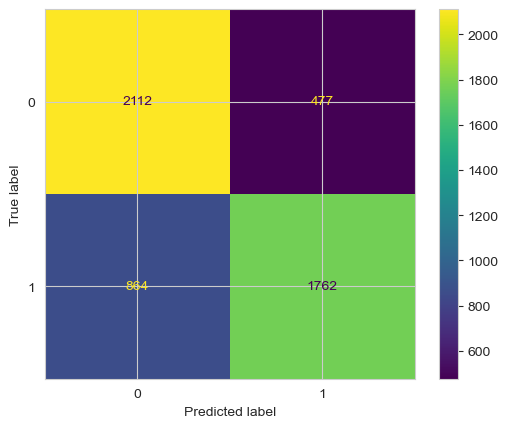

In [148]:
predict_dtr(X_train, y_train, grid)

              precision    recall  f1-score   support

           0       0.71      0.81      0.76       863
           1       0.78      0.68      0.73       876

    accuracy                           0.74      1739
   macro avg       0.75      0.74      0.74      1739
weighted avg       0.75      0.74      0.74      1739


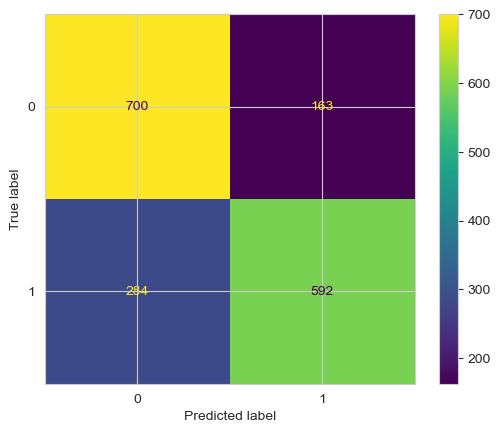

In [149]:
predict_dtr(X_val, y_val, grid)

              precision    recall  f1-score   support

           0       0.71      0.80      0.75       863
           1       0.78      0.68      0.73       876

    accuracy                           0.74      1739
   macro avg       0.74      0.74      0.74      1739
weighted avg       0.74      0.74      0.74      1739


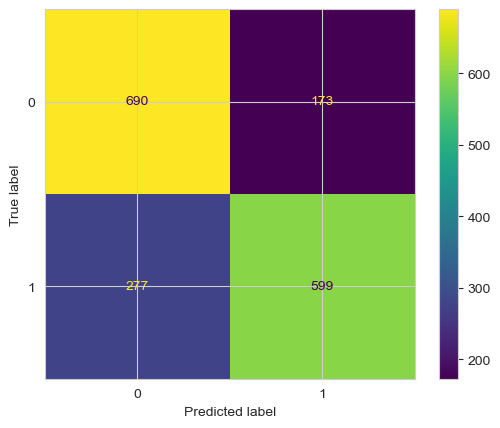

In [150]:
predict_dtr(X_test, y_test, grid)

### Без валидации

---

In [151]:
# grid = train_dtr(X_train_no_val, y_train_no_val)
grid = pipe_line(X_train, y_train)

Fitting 5 folds for each of 1900 candidates, totalling 9500 fits
[CV 4/5] END dec_tree__criterion=entropy, dec_tree__max_depth=2, dec_tree__min_samples_leaf=8, pca__n_components=13;, score=(train=0.720, test=0.725) total time=   0.0s
[CV 5/5] END dec_tree__criterion=entropy, dec_tree__max_depth=2, dec_tree__min_samples_leaf=8, pca__n_components=13;, score=(train=0.738, test=0.711) total time=   0.0s
[CV 1/5] END dec_tree__criterion=entropy, dec_tree__max_depth=2, dec_tree__min_samples_leaf=8, pca__n_components=14;, score=(train=0.735, test=0.711) total time=   0.0s
[CV 2/5] END dec_tree__criterion=entropy, dec_tree__max_depth=2, dec_tree__min_samples_leaf=8, pca__n_components=14;, score=(train=0.723, test=0.712) total time=   0.0s
[CV 3/5] END dec_tree__criterion=entropy, dec_tree__max_depth=2, dec_tree__min_samples_leaf=8, pca__n_components=14;, score=(train=0.725, test=0.728) total time=   0.0s
[CV 4/5] END dec_tree__criterion=entropy, dec_tree__max_depth=2, dec_tree__min_samples_lea

              precision    recall  f1-score   support

           0       0.71      0.81      0.76      3452
           1       0.78      0.67      0.72      3502

    accuracy                           0.74      6954
   macro avg       0.75      0.74      0.74      6954
weighted avg       0.75      0.74      0.74      6954


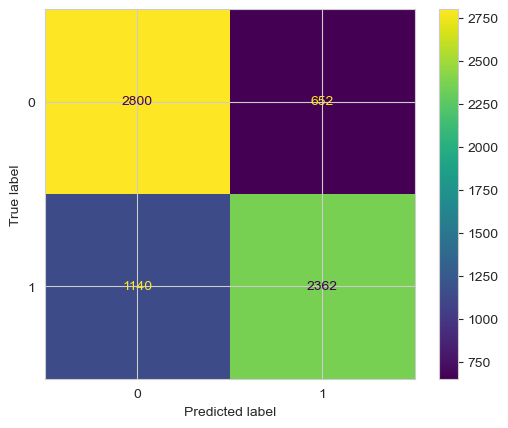

In [152]:
predict_dtr(X_train_no_val, y_train_no_val, grid)

              precision    recall  f1-score   support

           0       0.71      0.81      0.76       863
           1       0.79      0.67      0.73       876

    accuracy                           0.74      1739
   macro avg       0.75      0.74      0.74      1739
weighted avg       0.75      0.74      0.74      1739


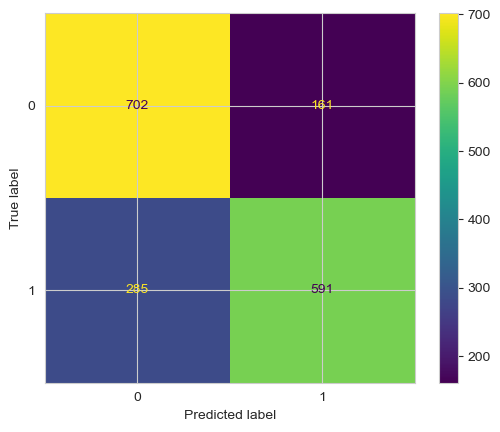

In [153]:
predict_dtr(X_test_no_val, y_test_no_val, grid)

## CatBoostClassifier

---

In [236]:
cols_to_drop = [
    "FirstName",
    "LastName",
    "AgeGroup",
    "AllExpanses",
    "WithoutExpanses"
]

In [237]:
def train_alg(X_train_: pd.DataFrame, y_train_: pd.DataFrame, alg_):
    print("Начало обучения...")
    grid_ = RandomizedSearchCV(
        alg_(verbose=1),
        param_distributions = {
            "max_depth": range(1, 12),
            "learning_rate": np.linspace(0.0001, 0.4, 1000),
        },
        scoring="accuracy",
        cv=5,
        n_jobs=-1,
        return_train_score=True,
        n_iter=10,
        verbose=1
    )

    grid_.fit(X_train_, y_train_)
    print(f"Лучшая метрика:   {grid_.best_score_}")
    print(f"Лучшие параметры: {grid_.best_params_}")

    print("Обучение завершено.")
    return grid_

### С валидацией

---

In [238]:
grid_cb = train_alg(X_train.drop(columns=cols_to_drop), y_train, cb.CatBoostClassifier)

Начало обучения...
Fitting 5 folds for each of 10 candidates, totalling 50 fits
584:	learn: 0.0095137	total: 13.2s	remaining: 9.35s
585:	learn: 0.0094951	total: 13.2s	remaining: 9.31s
586:	learn: 0.0094854	total: 13.2s	remaining: 9.28s
587:	learn: 0.0094796	total: 13.2s	remaining: 9.25s
588:	learn: 0.0094529	total: 13.2s	remaining: 9.22s
589:	learn: 0.0094173	total: 13.2s	remaining: 9.19s
590:	learn: 0.0093937	total: 13.2s	remaining: 9.15s
591:	learn: 0.0093586	total: 13.2s	remaining: 9.12s
592:	learn: 0.0093585	total: 13.2s	remaining: 9.09s
593:	learn: 0.0093216	total: 13.3s	remaining: 9.06s
594:	learn: 0.0092913	total: 13.3s	remaining: 9.03s
595:	learn: 0.0092913	total: 13.3s	remaining: 9s
596:	learn: 0.0092715	total: 13.3s	remaining: 8.97s
597:	learn: 0.0092201	total: 13.3s	remaining: 8.96s
598:	learn: 0.0091957	total: 13.3s	remaining: 8.94s
599:	learn: 0.0091662	total: 13.4s	remaining: 8.91s
600:	learn: 0.0091433	total: 13.4s	remaining: 8.89s
601:	learn: 0.0091204	total: 13.4s	rema

              precision    recall  f1-score   support

           0       0.85      0.82      0.84      2589
           1       0.83      0.86      0.84      2626

    accuracy                           0.84      5215
   macro avg       0.84      0.84      0.84      5215
weighted avg       0.84      0.84      0.84      5215


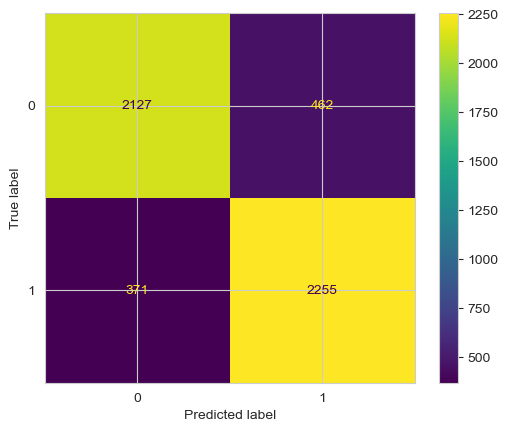

In [239]:
predict_dtr(X_train, y_train, grid_cb)

              precision    recall  f1-score   support

           0       0.82      0.78      0.80       863
           1       0.79      0.83      0.81       876

    accuracy                           0.80      1739
   macro avg       0.80      0.80      0.80      1739
weighted avg       0.80      0.80      0.80      1739


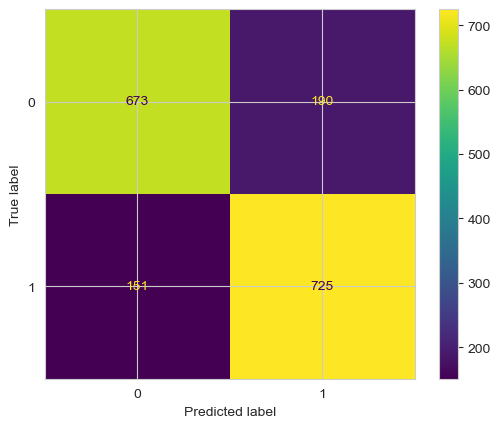

In [240]:
predict_dtr(X_val, y_val, grid_cb)

              precision    recall  f1-score   support

           0       0.80      0.78      0.79       863
           1       0.79      0.81      0.80       876

    accuracy                           0.79      1739
   macro avg       0.79      0.79      0.79      1739
weighted avg       0.79      0.79      0.79      1739


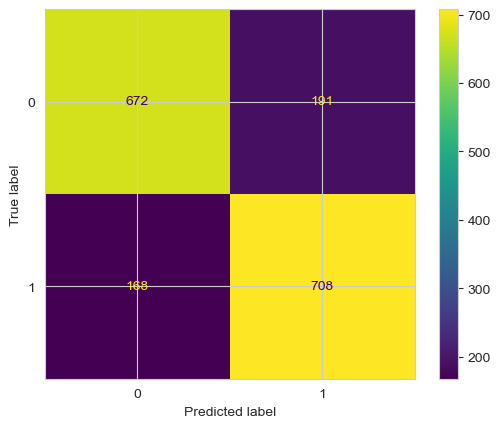

In [241]:
predict_dtr(X_test, y_test, grid_cb)

### Без валидации

---

In [166]:
grid_cb = train_alg(X_train, y_train, cb.CatBoostClassifier)
# grid_cb = pipe_line_x(X_train, y_train, cb.CatBoostClassifier)

Начало обучения...
Fitting 5 folds for each of 5 candidates, totalling 25 fits
580:	learn: 0.0195088	total: 15.2s	remaining: 10.9s
581:	learn: 0.0194488	total: 15.2s	remaining: 10.9s
582:	learn: 0.0194172	total: 15.2s	remaining: 10.9s
583:	learn: 0.0193911	total: 15.2s	remaining: 10.8s
584:	learn: 0.0193355	total: 15.3s	remaining: 10.8s
585:	learn: 0.0192935	total: 15.3s	remaining: 10.8s
586:	learn: 0.0192277	total: 15.3s	remaining: 10.8s
587:	learn: 0.0191054	total: 15.3s	remaining: 10.7s
588:	learn: 0.0190405	total: 15.3s	remaining: 10.7s
589:	learn: 0.0189654	total: 15.4s	remaining: 10.7s
590:	learn: 0.0189044	total: 15.4s	remaining: 10.6s
591:	learn: 0.0188780	total: 15.4s	remaining: 10.6s
592:	learn: 0.0188145	total: 15.4s	remaining: 10.6s
593:	learn: 0.0187865	total: 15.4s	remaining: 10.5s
594:	learn: 0.0187473	total: 15.4s	remaining: 10.5s
595:	learn: 0.0186786	total: 15.5s	remaining: 10.5s
596:	learn: 0.0185972	total: 15.5s	remaining: 10.4s
597:	learn: 0.0185395	total: 15.5s	re

              precision    recall  f1-score   support

           0       0.98      0.98      0.98      2589
           1       0.98      0.99      0.98      2626

    accuracy                           0.98      5215
   macro avg       0.98      0.98      0.98      5215
weighted avg       0.98      0.98      0.98      5215


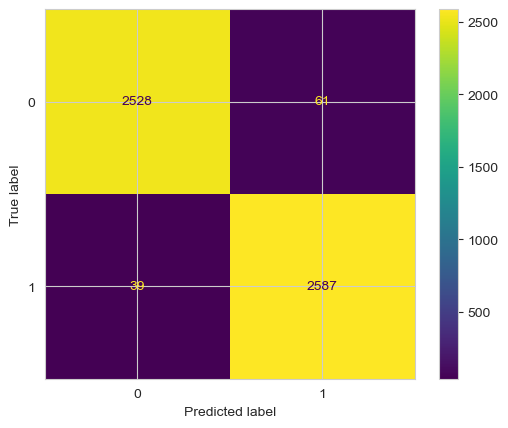

In [167]:
predict_dtr(X_train, y_train, grid_cb)

              precision    recall  f1-score   support

           0       0.78      0.81      0.79       863
           1       0.80      0.77      0.79       876

    accuracy                           0.79      1739
   macro avg       0.79      0.79      0.79      1739
weighted avg       0.79      0.79      0.79      1739


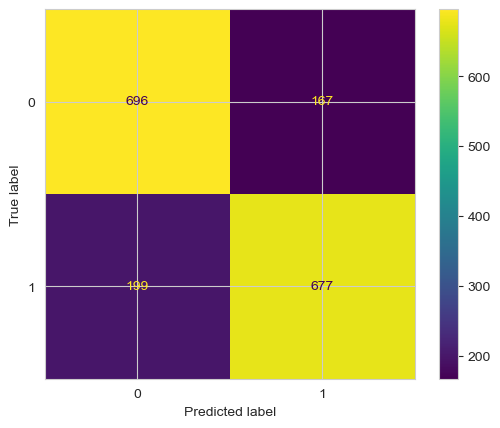

In [168]:
predict_dtr(X_test, y_test, grid_cb)

## LGBMClassifier

---

In [183]:
def pipe_line_x(X_, y_, alg_):
    std_slc = StandardScaler()
    pca = PCA()
    alg = alg_(verbose=1)

    n_components = list(range(1, X_.shape[1] + 1, 1))
    max_depth = list(range(1, 12))
    learning_rate = np.linspace(0.00001, 0.4, 10000)

    parameters = dict(
        pca__n_components=n_components,
        alg__max_depth=max_depth,
        alg__learning_rate=learning_rate
    )

    pipe = Pipeline(
        steps=[
            ("std_slc", std_slc),
            ("pca", pca),
            ("alg", alg)
        ]
    )

    grid_ = RandomizedSearchCV(
        pipe,
        param_distributions = parameters,
        scoring="accuracy",
        cv=10,
        n_jobs=-1,
        return_train_score=True,
        n_iter=20,
        verbose=1
    )
    grid_.fit(X_, y_)

    print(f"Лучшая метрика:   {grid_.best_score_}")
    print(f"Лучшие параметры: {grid_.best_params_}")

    print("Обучение завершено.")

    return grid_

### С валидацией

---

In [190]:
# grid_lgb = train_alg(X_train, y_train, lgb.LGBMClassifier)
grid_lgb = pipe_line_x(X_train.drop(columns=cols_to_drop), y_train, lgb.LGBMClassifier)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

/Users/mac/miniconda3/envs/ds/lib/python3.11/site-packages/lightgbm/basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
/Users/mac/miniconda3/envs/ds/lib/python3.11/site-packages/lightgbm/basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
/Users/mac/miniconda3/envs/ds/lib/python3.11/site-packages/lightgbm/basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
/Users/mac/miniconda3/envs/ds/lib/python3.11/site-packages/lightgbm/basic.py:506: UserWarning: Usage of np.ndarray subset (sliced dat

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000635 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5100
[LightGBM] [Info] Number of data points in the train set: 4693, number of used features: 20
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.503516 -> initscore=0.014064
[LightGBM] [Info] Start training from score 0.014064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

              precision    recall  f1-score   support

           0       0.94      0.95      0.95      2589
           1       0.95      0.94      0.95      2626

    accuracy                           0.95      5215
   macro avg       0.95      0.95      0.95      5215
weighted avg       0.95      0.95      0.95      5215


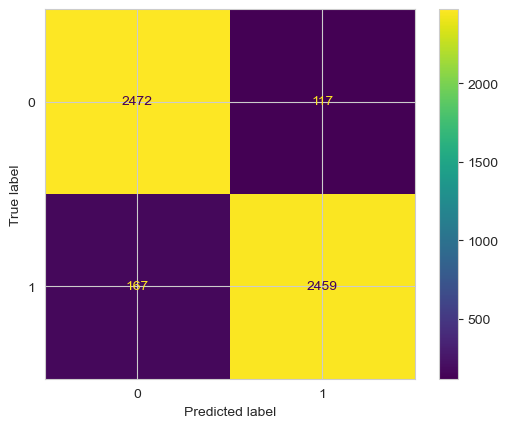

In [191]:
predict_dtr(X_train.drop(columns=cols_to_drop), y_train, grid_lgb)

              precision    recall  f1-score   support

           0       0.80      0.79      0.80       863
           1       0.80      0.80      0.80       876

    accuracy                           0.80      1739
   macro avg       0.80      0.80      0.80      1739
weighted avg       0.80      0.80      0.80      1739


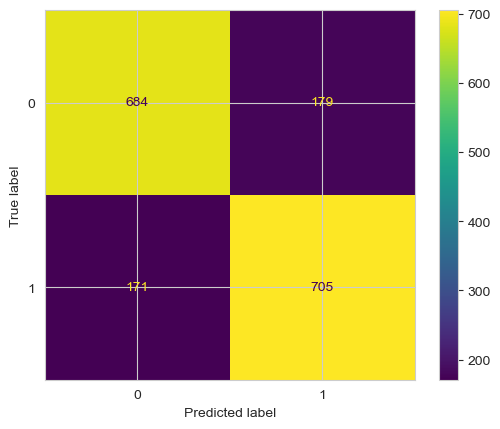

In [193]:
predict_dtr(X_val.drop(columns=cols_to_drop), y_val, grid_lgb)

              precision    recall  f1-score   support

           0       0.78      0.79      0.78       863
           1       0.79      0.78      0.79       876

    accuracy                           0.78      1739
   macro avg       0.78      0.78      0.78      1739
weighted avg       0.78      0.78      0.78      1739


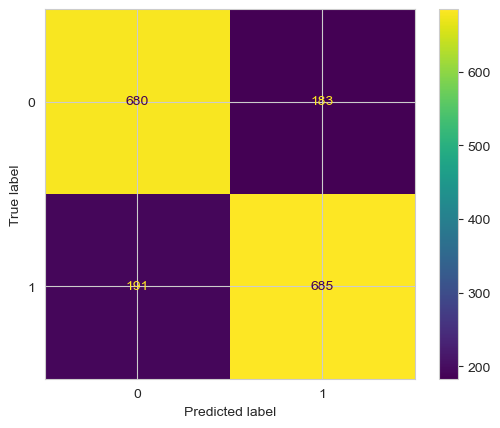

In [194]:
predict_dtr(X_test.drop(columns=cols_to_drop), y_test, grid_lgb)

### Без валидации

---

In [197]:
# grid_lgb = train_alg(X_train, y_train, lgb.LGBMClassifier)
grid_lgb = pipe_line_x(X_train.drop(columns=cols_to_drop), y_train, lgb.LGBMClassifier)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000138 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 4693, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.503516 -> initscore=0.014064
[LightGBM] [Info] Start training from score 0.014064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

              precision    recall  f1-score   support

           0       0.90      0.91      0.90      2589
           1       0.91      0.90      0.90      2626

    accuracy                           0.90      5215
   macro avg       0.90      0.90      0.90      5215
weighted avg       0.90      0.90      0.90      5215


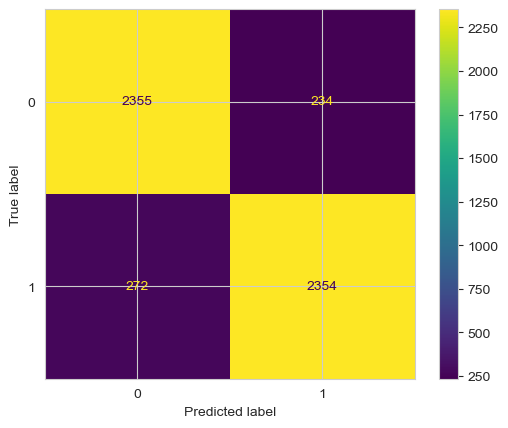

In [198]:
predict_dtr(X_train.drop(columns=cols_to_drop), y_train, grid_lgb)

              precision    recall  f1-score   support

           0       0.79      0.80      0.79       863
           1       0.80      0.79      0.79       876

    accuracy                           0.79      1739
   macro avg       0.79      0.79      0.79      1739
weighted avg       0.79      0.79      0.79      1739


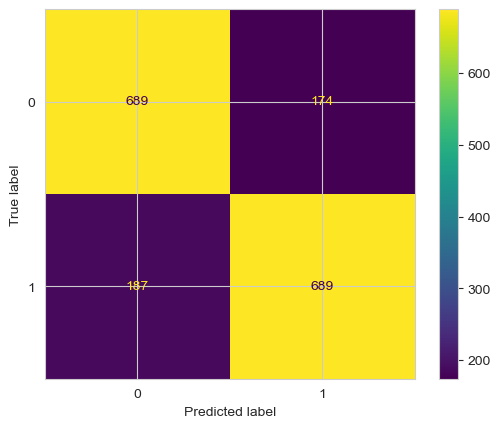

In [200]:
predict_dtr(X_test.drop(columns=cols_to_drop), y_test, grid_lgb)

# Финальный результат

---

Посмотрим на финальный результат:

## LGBMClassifier

In [201]:
grid_lgb = pipe_line_x(X_train_full.drop(columns=cols_to_drop), y_train_full, lgb.LGBMClassifier)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
[LightGBM] [Info] Number of positive: 2363, number of negative: 2330
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 765
[LightGBM] [Info] Number of data points in the train set: 4693, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.503516 -> initscore=0.014064
[LightGBM] [Info] Start training from score 0.014064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

/Users/mac/miniconda3/envs/ds/lib/python3.11/site-packages/lightgbm/basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
/Users/mac/miniconda3/envs/ds/lib/python3.11/site-packages/lightgbm/basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
/Users/mac/miniconda3/envs/ds/lib/python3.11/site-packages/lightgbm/basic.py:506: UserWarning: Usage of np.ndarray subset (sliced data) is not recommended due to it will double the peak memory cost in LightGBM.
  _log_warning("Usage of np.ndarray subset (sliced data) is not recommended "
/Users/mac/miniconda3/envs/ds/lib/python3.11/site-packages/lightgbm/basic.py:506: UserWarning: Usage of np.ndarray subset (sliced dat

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

              precision    recall  f1-score   support

           0       0.85      0.87      0.86      4315
           1       0.87      0.85      0.86      4378

    accuracy                           0.86      8693
   macro avg       0.86      0.86      0.86      8693
weighted avg       0.86      0.86      0.86      8693


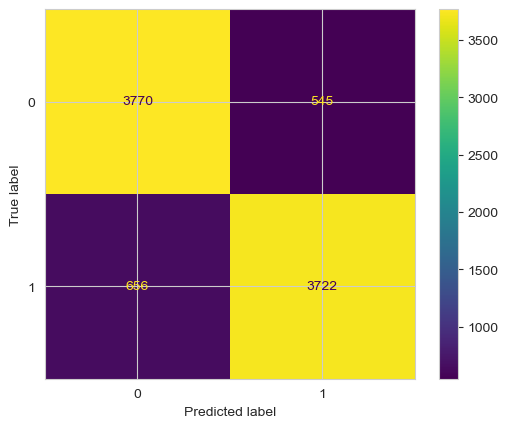

In [206]:
predict_dtr(X_train_full.drop(columns=cols_to_drop), y_train_full, grid_lgb)

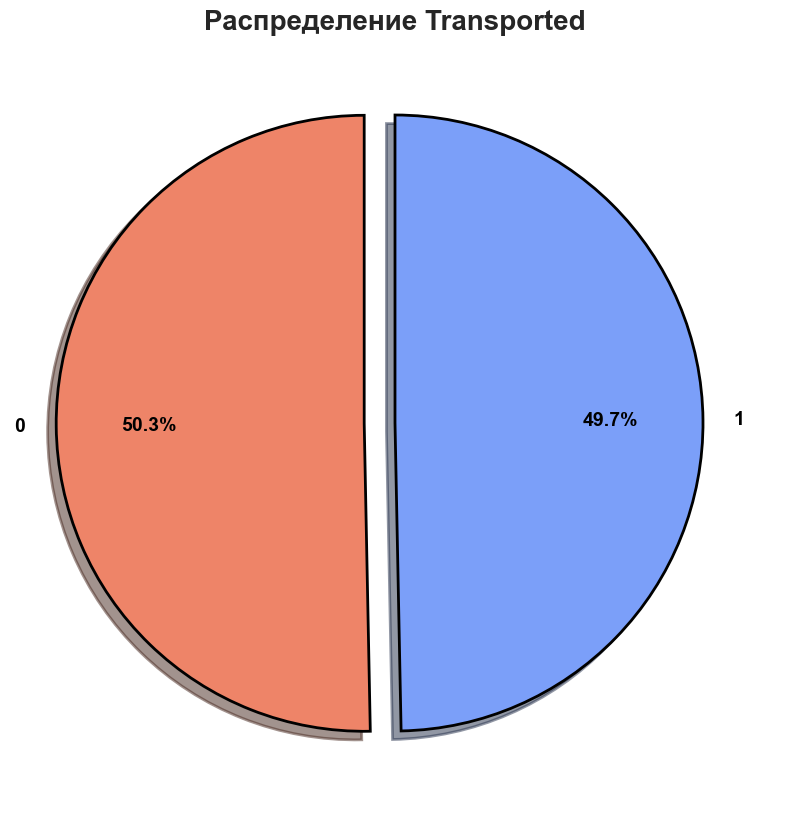

In [207]:
test_df[target_col] = grid_lgb.best_estimator_.predict(test_df.drop(columns=cols_to_drop))
test_df["PassengerId"] = test_df[["PassengerIdGroup", "PassengerIdNum"]].apply(lambda x: f"{x[0]:04d}_{x[1]:02d}", axis=1)
test_df[target_col] = test_df[target_col].astype(bool)
test_df[["PassengerId", target_col]].to_csv("submission.csv", index=False)
plot_target_pie(test_df, target_col)

In [208]:
df_sample = pd.read_csv("/Users/mac/education/sber_university/main/2. RN/group_project/2/data/spaceship-titanic/sample_submission.csv")

## CatBoostClassifier

Начало обучения...
Fitting 5 folds for each of 10 candidates, totalling 50 fits
694:	learn: 0.0750396	total: 3.24s	remaining: 1.42s
695:	learn: 0.0749068	total: 3.24s	remaining: 1.42s
696:	learn: 0.0748032	total: 3.24s	remaining: 1.41s
697:	learn: 0.0746387	total: 3.24s	remaining: 1.4s
698:	learn: 0.0745042	total: 3.25s	remaining: 1.4s
699:	learn: 0.0743701	total: 3.25s	remaining: 1.39s
700:	learn: 0.0743114	total: 3.25s	remaining: 1.39s
701:	learn: 0.0742938	total: 3.25s	remaining: 1.38s
702:	learn: 0.0741625	total: 3.26s	remaining: 1.38s
703:	learn: 0.0741273	total: 3.26s	remaining: 1.37s
704:	learn: 0.0740242	total: 3.26s	remaining: 1.36s
705:	learn: 0.0738102	total: 3.27s	remaining: 1.36s
706:	learn: 0.0737162	total: 3.29s	remaining: 1.36s
707:	learn: 0.0735527	total: 3.29s	remaining: 1.36s
708:	learn: 0.0733930	total: 3.32s	remaining: 1.36s
709:	learn: 0.0731313	total: 3.33s	remaining: 1.36s
710:	learn: 0.0730338	total: 3.33s	remaining: 1.35s
711:	learn: 0.0729381	total: 3.35s	rem

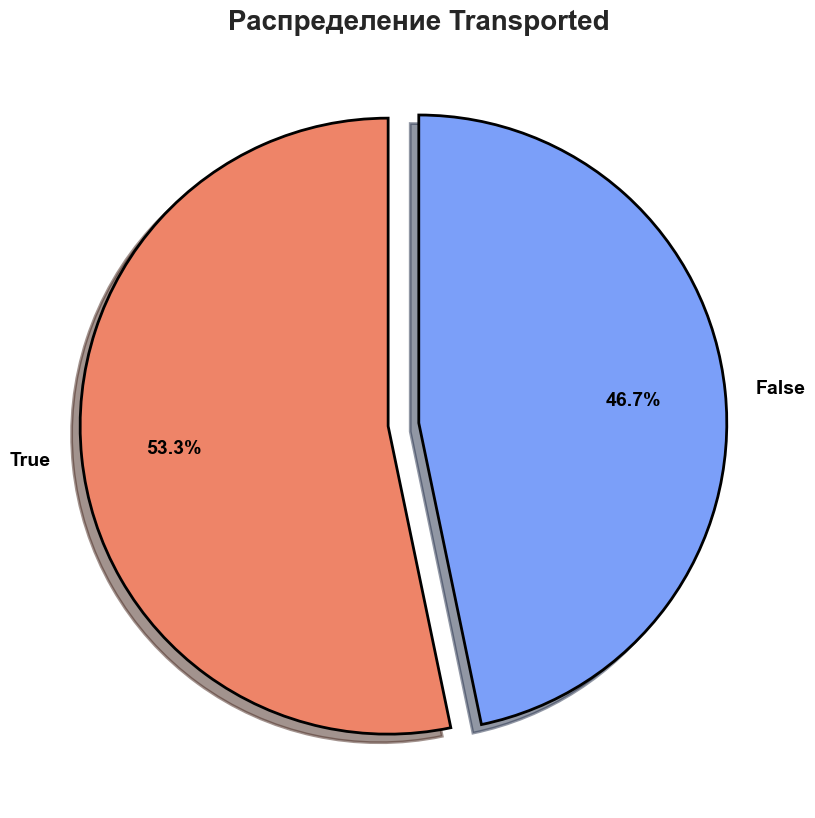

In [247]:
grid_cb = train_alg(X_train_full.drop(columns=cols_to_drop), y_train_full, cb.CatBoostClassifier)
test_df[target_col] = grid_cb.best_estimator_.predict(test_df.drop(columns=cols_to_drop))

test_df["PassengerId"] = test_df[["PassengerIdGroup", "PassengerIdNum"]].apply(lambda x: f"{x[0]:04d}_{x[1]:02d}", axis=1)
test_df[target_col] = test_df[target_col].astype(bool)
test_df[["PassengerId", target_col]].to_csv("submission_cb.csv", index=False)
plot_target_pie(test_df, target_col)